In [14]:
path1="/content/drive/MyDrive/img-20220315T095751Z-001.zip"
path2="/content/drive/MyDrive/img-20220315T095751Z-002.zip"
from zipfile import ZipFile
with ZipFile(path1) as f:
  f.extractall()
  print("Done-1")
from zipfile import ZipFile
with ZipFile(path2) as f:
  f.extractall()
  print("Done-2")

Done-1
Done-2


In [ ]:
import glob
path="/content/img"
c=0
for i in glob.glob(path+"/*.jpg"):
  c+=1
print(c)

8625


In [ ]:
import os
import re
import pickle
import string
import unicodedata
from random import randint

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from nltk.corpus import stopwords
from wordcloud import STOPWORDS, WordCloud

from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras import Input, Model
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.layers import LSTM, Bidirectional, Dense, Embedding, TimeDistributed

In [ ]:
!pip install -q contractions==0.0.48

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.2/103.2 KB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 KB 14.6 MB/s eta 0:00:00


In [ ]:
from contractions import contractions_dict

for key, value in list(contractions_dict.items())[:10]:
    print(f'{key} == {value}')

I'm == I am
I'm'a == I am about to
I'm'o == I am going to
I've == I have
I'll == I will
I'll've == I will have
I'd == I would
I'd've == I would have
Whatcha == What are you
amn't == am not


In [ ]:
# Using TPU

# detect and init the TPU
tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)

# instantiate a distribution strategy
tpu_strategy = tf.distribute.TPUStrategy(tpu)

# Getting Data Ready

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/rafibodysummaryfinal (1).csv", encoding='iso-8859-1').reset_index(drop=True)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df.head()

,@body,@summary
0,Five years ago Giuliana Rancic had a double ma...,In 2012 she had a double mastectomy as she bat...
1,Genetically-modified cows are being bred witho...,Scientists have created the cows to protect fa...
2,She carved out a role as a pathbreaking profes...,Ivanka Trump was a constant presence at her fa...
3,A couple who made # 1million from cocaine blew...,Carl and Donna Honey-Jones used drug dealing e...
4,Though he did n't come dressed as a scary curs...,"Joel Lynch , an Iowa State University senior ,..."


In [ ]:
df.rename(
    columns=({ "@body": "body", "@summary": "summary"}),
    inplace=True,
)

In [ ]:
df.sample(5)

,body,summary
23829,President-elect Donald Trump said this afterno...,Senate Republicans are aiming to have a half d...
5485,"Amid the dying embers of her marriage , Christ...","Christine Corbett , 48 , said she was never in..."
13438,The past year has brought change -- in some ca...,Menopause has in some ways been most dramatic ...
27425,The youngest victim of Melbourne 's Bourke Str...,Three-month-old baby who died in the Bourke St...
13642,\nExecutives at the advertising website Backpa...,Executives at the website Backpage.com refused...


In [ ]:
df.summary

0        In 2012 she had a double mastectomy as she bat...
1        Scientists have created the cows to protect fa...
2        Ivanka Trump was a constant presence at her fa...
3        Carl and Donna Honey-Jones used drug dealing e...
4        Joel Lynch , an Iowa State University senior ,...
                               ...                        
44002    Pictures taken in 1809s in Constantinople have...
44003    West Ham vice-chairman Karren Brady shares the...
44004    Mujahid is accused of arranging meetings and i...
44005    Joanna Dennehy stabbed three men to death befo...
44006                                             @summary
Name: summary, Length: 44007, dtype: object

In [ ]:
c=0
for i in range(len(df.summary)):
  if type(df.summary[i])==float:
    df.summary[i]=str(df.summary[i])
  for j in df.summary[i]:
    if type(j)==float:
      c+=1
print(c)

0


In [ ]:
c=0
for i in range(len(df.body)):
  if type(df.body[i])==float:
    df.body[i]=str(df.body[i])
  for j in df.body[i]:
    if type(j)==float:
      c+=1
print(c)

0


In [ ]:
df.summary[999]

'The 35-year-old stepped out of her Park Avenue apartment and headed to work in a $ 113 mauve-colored velvet dress by Oasis on Friday morning\n\n\n'

In [ ]:
df = df.sample(frac=1).reset_index(drop=True)

print(f'Dataset size: {len(df)}')
df.sample(5)

Dataset size: 44007


,body,summary
41065,English cricket has been plunged into civil wa...,English cricket has been plunged into civil wa...
609,It it a unique glimpse of our planet - from an...,Images were taken from NASA 's Mars Reconnaiss...
2248,A childcare worker is taking her employee to c...,Stephanie Lauren Fry is suing Goodstart Early ...
17111,A gang of fraudsters scattered across the UK h...,"Hacker Edward Mullen , 30 , obtained log-in de..."
36888,Former President George W. Bush and his wife L...,George W. Bush and his wife Laura attended Don...


In [ ]:
#df[body]

# Data Preparation

In [ ]:
def expand_contractions(text, contraction_map=contractions_dict):
    # Using regex for getting all contracted words
    contractions_keys = '|'.join(contraction_map.keys())
    contractions_pattern = re.compile(f'({contractions_keys})', flags=re.DOTALL)

    def expand_match(contraction):
        # Getting entire matched sub-string
        match = contraction.group(0)
        expanded_contraction = contraction_map.get(match)
        if not expand_contractions:
            print(match)
            return match
        return expanded_contraction

    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text


expand_contractions("y'all can't expand contractions i'd think")

'you all can not expand contractions id think'

In [ ]:
# Converting to lowercase
df.body = df.body.apply(str.lower)
df.summary = df.summary.apply(str.lower)

df.sample(5)

,body,summary
27524,\nthis is the horrifying moment a 39-year-old ...,lakinta cosby faces a murder charge after runn...
20248,a twitter user set out to see how much men rea...,alabama vlogger selena faye shared an image of...
24830,a federal magistrate has declined to immediate...,"daniel ramirez-medina , 23 , has been in the u..."
25526,a muslim woman had said she was spat at and as...,"nahella ashraf , 46 , was attending a conferen..."
21721,george osborne is clearly enjoying life after ...,george osborne pictured with the famous couple...


In [ ]:
def rm_punc_from_word(word):
    clean_alphabet_list = [
        alphabet for alphabet in word if alphabet not in string.punctuation
    ]
    return ''.join(clean_alphabet_list)

print(rm_punc_from_word('#cool!'))


# Remove puncuation from text
def rm_punc_from_text(text):
    clean_word_list = [rm_punc_from_word(word) for word in text]
    return ''.join(clean_word_list)

print(rm_punc_from_text("Frankly, my dear, I don't give a damn"))

cool
Frankly my dear I dont give a damn


In [ ]:
def rm_number_from_text(text):
    text = re.sub('[0-9]+', '', text)
    return ' '.join(text.split())  # to rm `extra` white space

print(rm_number_from_text('You are 100times more sexier than me'))
print(rm_number_from_text('If you taught yes then you are 10 times more delusional than me'))

You are times more sexier than me
If you taught yes then you are times more delusional than me


In [ ]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# Remove stopwords from text
def rm_stopwords_from_text(text):
    _stopwords = stopwords.words('english')
    text = text.split()
    word_list = [word for word in text if word not in _stopwords]
    return ' '.join(word_list)

rm_stopwords_from_text("Love means never having to say you're sorry")

'Love means never say sorry'

In [ ]:
# Cleaning text
def clean_text(text):
    text = str(text).lower()
    text = rm_punc_from_text(text)
    text = rm_number_from_text(text)
    text = rm_stopwords_from_text(text)

    # there are hyphen(–) in many titles, so replacing it with empty str
    # this hyphen(–) is different from normal hyphen(-)
    text = re.sub('–', '', text)
    text = ' '.join(text.split())  # removing `extra` white spaces

    # Removing unnecessary characters from text
    text = re.sub("(\\t)", ' ', str(text)).lower()
    text = re.sub("(\\r)", ' ', str(text)).lower()
    text = re.sub("(\\n)", ' ', str(text)).lower()

    # remove accented chars ('Sómě Áccěntěd těxt' => 'Some Accented text')
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode(
        'utf-8', 'ignore'
    )

    text = re.sub("(__+)", ' ', str(text)).lower()
    text = re.sub("(--+)", ' ', str(text)).lower()
    text = re.sub("(~~+)", ' ', str(text)).lower()
    text = re.sub("(\+\++)", ' ', str(text)).lower()
    text = re.sub("(\.\.+)", ' ', str(text)).lower()

    text = re.sub(r"[<>()|&©ø\[\]\'\",;?~*!]", ' ', str(text)).lower()

    text = re.sub("(mailto:)", ' ', str(text)).lower()
    text = re.sub(r"(\\x9\d)", ' ', str(text)).lower()
    text = re.sub("([iI][nN][cC]\d+)", 'INC_NUM', str(text)).lower()
    text = re.sub("([cC][mM]\d+)|([cC][hH][gG]\d+)", 'CM_NUM',
                  str(text)).lower()

    text = re.sub("(\.\s+)", ' ', str(text)).lower()
    text = re.sub("(\-\s+)", ' ', str(text)).lower()
    text = re.sub("(\:\s+)", ' ', str(text)).lower()
    text = re.sub("(\s+.\s+)", ' ', str(text)).lower()

    try:
        url = re.search(r'((https*:\/*)([^\/\s]+))(.[^\s]+)', str(text))
        repl_url = url.group(3)
        text = re.sub(r'((https*:\/*)([^\/\s]+))(.[^\s]+)', repl_url, str(text))
    except Exception as e:
        pass

    text = re.sub("(\s+)", ' ', str(text)).lower()
    text = re.sub("(\s+.\s+)", ' ', str(text)).lower()

    return text

clean_text("Mrs. Robinson, you're trying to seduce me, aren't you?")

'mrs robinson youre trying seduce arent'

In [ ]:
df.body = df.body.apply(clean_text)
df.summary = df.summary.apply(clean_text)
df.sample(5)

,body,summary
32796,rafa benitez told mike ashley newcastle united...,supporters concerned rafa benitez mike ashley ...
7665,rangers caretaker boss graeme murty admits sun...,rangers caretaker boss graeme murty manage tea...
32018,thought clashing colours fashion nono think pi...,pink red paired autumnwinter catwalks
31609,italian sports journalist targeted hackers lea...,nude pictures sports journalist diletta leotta...
33973,purchase perfect item online arrive days later...,customers revealed biggest online shopping dis...


In [ ]:
# saving the cleaned data
df.to_csv('/content/drive/MyDrive/dataset/cleaned_data1.csv')

In [ ]:
# To customize colours of wordcloud texts
def wc_blue_color_func(word, font_size, position, orientation, random_state=None, **kwargs):
    return "hsl(214, 67%%, %d%%)" % randint(60, 100)


# stopwords for wordcloud
def get_wc_stopwords():
    wc_stopwords = set(STOPWORDS)

    # Adding words to stopwords
    # these words showed up while plotting wordcloud for text
    wc_stopwords.add('s')
    wc_stopwords.add('one')
    wc_stopwords.add('using')
    wc_stopwords.add('example')
    wc_stopwords.add('work')
    wc_stopwords.add('use')
    wc_stopwords.add('make')

    return wc_stopwords


# plot wordcloud
def plot_wordcloud(text, color_func):
    wc_stopwords = get_wc_stopwords()
    wc = WordCloud(stopwords=wc_stopwords, width=1200, height=600, random_state=0).generate(text)

    f, axs = plt.subplots(figsize=(20, 10))
    with sns.axes_style("ticks"):
        sns.despine(offset=10, trim=True)
        plt.imshow(wc.recolor(color_func=color_func, random_state=0), interpolation="bilinear")
        plt.xlabel('WordCloud')

In [ ]:
##plot_wordcloud(' '.join(df.body.values.tolist()), wc_blue_color_func)

In [ ]:
#plot_wordcloud(' '.join(df.summary.values.tolist()), wc_blue_color_func)

In [ ]:
#df.summary = df.summary.apply(lambda x: f'_START_ {x} _END_')

In [ ]:
start_token = 'sostok'
end_token = 'eostok'
df.summary = df.summary.apply(lambda x: f'{start_token} {x} {end_token}')

In [ ]:
df.sample(5)

,body,summary
41503,london welsh removed english rugby professiona...,sostok london welsh stripped ranks professiona...
11929,west ham announced signing southampton captain...,sostok west ham race euro winner jose fonte eo...
1837,formartine may map literal sense highland leag...,sostok fortmartine reached scottish cup fourth...
6521,italian sports journalist targeted hackers lea...,sostok nude pictures sports journalist diletta...
5878,china new quirky building add collection new s...,sostok new storey building shaped like boat co...


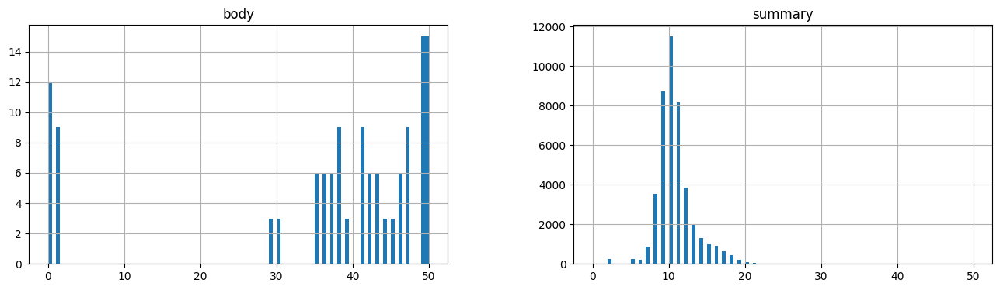

In [ ]:
text_count = [len(sentence.split()) for sentence in df.body]
headlines_count = [len(sentence.split()) for sentence in df.summary]

pd.DataFrame({'body': text_count, 'summary': headlines_count}).hist(bins=100, figsize=(16, 4), range=[0, 50])
plt.show()

In [ ]:
# To check how many rows in a column has length (of the text) <= limit
def get_word_percent(column, limit):
    count = 0
    for sentence in column:
        if len(sentence.split()) <= limit:
            count += 1

    return round(count / len(column), 2)


# Check how many % of headlines have 0-13 words
print(get_word_percent(df.summary, 13))

# Check how many % of summary have 0-42 words
print(get_word_percent(df.body, 42))

0.89
0.0


In [ ]:
#42,13
max_text_len = 42
max_summary_len = 13

In [ ]:
# select the summary and text between their defined max lens respectively
def trim_text_and_summary(df, max_text_len, max_summary_len):
    cleaned_text = np.array(df['body'])
    cleaned_summary = np.array(df['summary'])

    short_text = []
    short_summary = []

    for i in range(len(cleaned_text)):
        if len(cleaned_text[i].split()) <= max_text_len and len(
            cleaned_summary[i].split()
        ) <= max_summary_len:
            short_text.append(cleaned_text[i])
            short_summary.append(cleaned_summary[i])

    df = pd.DataFrame({'text': short_text, 'summary': short_summary})
    return df


df = trim_text_and_summary(df, max_text_len, max_summary_len)
print(f'Dataset size: {len(df)}')
df.sample(5)

Dataset size: 63


,text,summary
47,,sostok clermont motor hotel atlanta used al ca...
0,raf fighter jets reportedly scrambled escort p...,sostok fighter jets reportedly scrambled escor...
6,british tourists injured bus crashed national ...,sostok police say uk us involved crash tongari...
10,resort season full swing coolest swim styles h...,sostok sofia hilary sported stylish swimwear b...
26,resort season full swing coolest swim styles h...,sostok sofia hilary sported stylish swimwear b...


In [ ]:
# rare word analysis
def get_rare_word_percent(tokenizer, threshold):
    # threshold: if the word's occurrence is less than this then it's rare word

    count = 0
    total_count = 0
    frequency = 0
    total_frequency = 0

    for key, value in tokenizer.word_counts.items():
        total_count += 1
        total_frequency += value
        if value < threshold:
            count += 1
            frequency += value

    return {
        'percent': round((count / total_count) * 100, 2),
        'total_coverage': round(frequency / total_frequency * 100, 2),
        'count': count,
        'total_count': total_count
    }

In [ ]:
# Splitting the training and validation sets
x_train, x_val, y_train, y_val = train_test_split(
    np.array(df['text']),
    np.array(df['summary']),
    test_size=0.1,
    random_state=1,
    shuffle=True
)

###Tokenizing text

In [ ]:
x_tokenizer = Tokenizer()
x_tokenizer.fit_on_texts(list(x_train))

x_tokens_data = get_rare_word_percent(x_tokenizer, 4)
print(x_tokens_data)

{'percent': 86.39, 'total_coverage': 71.92, 'count': 438, 'total_count': 507}


In [ ]:
# else use this
x_tokenizer = Tokenizer()
x_tokenizer.fit_on_texts(list(x_train))

In [ ]:
# save tokenizer
with open('/content/drive/MyDrive/dataset/x_tokenizer', 'wb') as f:
    pickle.dump(x_tokenizer, f, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
# one-hot-encoding
x_train_sequence = x_tokenizer.texts_to_sequences(x_train)
x_val_sequence = x_tokenizer.texts_to_sequences(x_val)

# padding upto max_text_len
x_train_padded = pad_sequences(x_train_sequence, maxlen=max_text_len, padding='post')
x_val_padded = pad_sequences(x_val_sequence, maxlen=max_text_len, padding='post')

# if you're not using num_words parameter in Tokenizer then use this
x_vocab_size = len(x_tokenizer.word_index) + 1

# else use this
# x_vocab_size = x_tokenizer.num_words + 1

print(x_vocab_size)

508


###Tokenizing summary

In [ ]:
y_tokenizer = Tokenizer()
y_tokenizer.fit_on_texts(list(y_train))

y_tokens_data = get_rare_word_percent(y_tokenizer, 6)
print(y_tokens_data)

{'percent': 94.85, 'total_coverage': 70.48, 'count': 129, 'total_count': 136}


In [ ]:
# else use this
y_tokenizer = Tokenizer()
y_tokenizer.fit_on_texts(list(y_train))

In [ ]:
# save tokenizer
with open('/content/drive/MyDrive/dataset/y_tokenizer', 'wb') as f:
    pickle.dump(y_tokenizer, f, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
# one-hot-encoding
y_train_sequence = y_tokenizer.texts_to_sequences(y_train)
y_val_sequence = y_tokenizer.texts_to_sequences(y_val)

# padding upto max_summary_len
y_train_padded = pad_sequences(y_train_sequence, maxlen=max_summary_len, padding='post')
y_val_padded = pad_sequences(y_val_sequence, maxlen=max_summary_len, padding='post')

# if you're not using num_words parameter in Tokenizer then use this
y_vocab_size = len(y_tokenizer.word_index) + 1

# else use this
# y_vocab_size = y_tokenizer.num_words + 1

print(y_vocab_size)

137


In [ ]:
# removing summary which only has sostok & eostok
def remove_indexes(summary_array):
    remove_indexes = []
    for i in range(len(summary_array)):
        count = 0
        for j in summary_array[i]:
            if j != 0:
                count += 1
        if count == 2:
            remove_indexes.append(i)
    return remove_indexes


remove_train_indexes = remove_indexes(y_train_padded)
remove_val_indexes = remove_indexes(y_val_padded)

y_train_padded = np.delete(y_train_padded, remove_train_indexes, axis=0)
x_train_padded = np.delete(x_train_padded, remove_train_indexes, axis=0)

y_val_padded = np.delete(y_val_padded, remove_val_indexes, axis=0)
x_val_padded = np.delete(x_val_padded, remove_val_indexes, axis=0)

##Modeling

In [ ]:
#45,num_epochs=20
latent_dim = 240
embedding_dim = 300
num_epochs = 33

In [ ]:
f=open("/content/drive/MyDrive/glove.6B.300d.txt",'r')
fr=f.readlines()
fr

['the 0.04656 0.21318 -0.0074364 -0.45854 -0.035639 0.23643 -0.28836 0.21521 -0.13486 -1.6413 -0.26091 0.032434 0.056621 -0.043296 -0.021672 0.22476 -0.075129 -0.067018 -0.14247 0.038825 -0.18951 0.29977 0.39305 0.17887 -0.17343 -0.21178 0.23617 -0.063681 -0.42318 -0.11661 0.093754 0.17296 -0.33073 0.49112 -0.68995 -0.092462 0.24742 -0.17991 0.097908 0.083118 0.15299 -0.27276 -0.038934 0.54453 0.53737 0.29105 -0.0073514 0.04788 -0.4076 -0.026759 0.17919 0.010977 -0.10963 -0.26395 0.07399 0.26236 -0.1508 0.34623 0.25758 0.11971 -0.037135 -0.071593 0.43898 -0.040764 0.016425 -0.4464 0.17197 0.046246 0.058639 0.041499 0.53948 0.52495 0.11361 -0.048315 -0.36385 0.18704 0.092761 -0.11129 -0.42085 0.13992 -0.39338 -0.067945 0.12188 0.16707 0.075169 -0.015529 -0.19499 0.19638 0.053194 0.2517 -0.34845 -0.10638 -0.34692 -0.19024 -0.2004 0.12154 -0.29208 0.023353 -0.11618 -0.35768 0.062304 0.35884 0.02906 0.0073005 0.0049482 -0.15048 -0.12313 0.19337 0.12173 0.44503 0.25147 0.10781 -0.17716 0.03

In [ ]:
def get_embedding_matrix(tokenizer, embedding_dim, vocab_size=None):
    word_index = tokenizer.word_index
    voc = list(word_index.keys())

    path_to_glove_file = "/content/drive/MyDrive/glove.6B.300d.txt"

    embeddings_index = {}
    with open(path_to_glove_file) as f:
        for line in f:
            word, coefs = line.split(maxsplit=1)
            coefs = np.fromstring(coefs, "f", sep=" ")
            embeddings_index[word] = coefs

    print("Found %s word vectors." % len(embeddings_index))

    num_tokens = len(voc) + 2 if not vocab_size else vocab_size
    hits = 0
    misses = 0

    # Prepare embedding matrix
    embedding_matrix = np.zeros((num_tokens, embedding_dim))
    for word,i in word_index.items():
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:
            # Words not found in embedding index will be all-zeros.
            # This includes the representation for "padding" and "OOV"
            embedding_matrix[i] = embedding_vector
            hits+= 1
        else:
            misses+= 1
    print("Converted %d words (%d misses)" % (hits, misses))

    return embedding_matrix


x_embedding_matrix = get_embedding_matrix(x_tokenizer, embedding_dim, x_vocab_size)
y_embedding_matrix = get_embedding_matrix(y_tokenizer, embedding_dim, y_vocab_size)

Found 400000 word vectors.
Converted 496 words (11 misses)
Found 400000 word vectors.
Converted 128 words (8 misses)


In [ ]:
print(x_embedding_matrix.shape)
print(y_embedding_matrix.shape)

(508, 300)
(137, 300)


In [ ]:
def build_seq2seq_model_with_just_lstm(
    embedding_dim, latent_dim, max_text_len,
    x_vocab_size, y_vocab_size,
    x_embedding_matrix, y_embedding_matrix
):
    # instantiating the model in the strategy scope creates the model on the TPU
    with tpu_strategy.scope():

        # =====================
        # 🔥 Encoder
        # =====================
        encoder_input = Input(shape=(max_text_len, ))

        # encoder embedding layer
        encoder_embedding = Embedding(
            x_vocab_size,
            embedding_dim,
            embeddings_initializer=tf.keras.initializers.Constant(x_embedding_matrix),
            trainable=False
        )(encoder_input)

        # encoder lstm 1
        encoder_lstm1 = LSTM(
            latent_dim,
            return_sequences=True,
            return_state=True,
            dropout=0.4,
            recurrent_dropout=0.4
        )
        encoder_output1, state_h1, state_c1 = encoder_lstm1(encoder_embedding)

        # encoder lstm 2
        encoder_lstm2 = LSTM(
            latent_dim,
            return_sequences=True,
            return_state=True,
            dropout=0.4,
            recurrent_dropout=0.4
        )
        encoder_output, *encoder_final_states = encoder_lstm2(encoder_output1)

        # =====================
        # 🌈 Decoder
        # =====================

        # Set up the decoder, using `encoder_states` as initial state.

        decoder_input = Input(shape=(None, ))

        # decoder embedding layer
        decoder_embedding_layer = Embedding(
            y_vocab_size,
            embedding_dim,
            embeddings_initializer=tf.keras.initializers.Constant(y_embedding_matrix),
            trainable=True
        )
        decoder_embedding = decoder_embedding_layer(decoder_input)

        # decoder lstm 1
        decoder_lstm = LSTM(
            latent_dim,
            return_sequences=True,
            return_state=True,
            dropout=0.4,
            recurrent_dropout=0.4
        )
        decoder_output, *decoder_final_states = decoder_lstm(
            decoder_embedding, initial_state=encoder_final_states
        )

        # dense layer
        decoder_dense = TimeDistributed(
            Dense(y_vocab_size, activation='softmax')
        )
        decoder_output = decoder_dense(decoder_output)

        # =====================
        # ⚡️ Model
        # =====================
        model = Model([encoder_input, decoder_input], decoder_output)
        model.summary()

        optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001)
        model.compile(
            optimizer=optimizer,
            loss='sparse_categorical_crossentropy',
            metrics=['accuracy']
        )

        return {
            'model': model,
            'inputs': {
                'encoder': encoder_input,
                'decoder': decoder_input
            },
            'outputs': {
                'encoder': encoder_output,
                'decoder': decoder_output
            },
            'states': {
                'encoder': encoder_final_states,
                'decoder': decoder_final_states
            },
            'layers': {
                'decoder': {
                    'embedding': decoder_embedding_layer,
                    'last_decoder_lstm': decoder_lstm,
                    'dense': decoder_dense
                }
            }
        }

In [ ]:
seq2seq = build_seq2seq_model_with_just_lstm(
    embedding_dim, latent_dim, max_text_len,
    x_vocab_size, y_vocab_size,
    x_embedding_matrix, y_embedding_matrix
)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 42)]         0           []                               
                                                                                                  
 embedding (Embedding)          (None, 42, 300)      152400      ['input_1[0][0]']                
                                                                                                  
 input_2 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 lstm (LSTM)                    [(None, 42, 240),    519360      ['embedding[0][0]']              
                                 (None, 240),                                                 

In [ ]:
model = seq2seq['model']

encoder_input = seq2seq['inputs']['encoder']
decoder_input = seq2seq['inputs']['decoder']

encoder_output = seq2seq['outputs']['encoder']
decoder_output = seq2seq['outputs']['decoder']

encoder_final_states = seq2seq['states']['encoder']
decoder_final_states = seq2seq['states']['decoder']

decoder_embedding_layer = seq2seq['layers']['decoder']['embedding']
last_decoder_lstm = seq2seq['layers']['decoder']['last_decoder_lstm']
decoder_dense = seq2seq['layers']['decoder']['dense']


In [ ]:
model.layers[-2].input

[<KerasTensor: shape=(None, None, 300) dtype=float32 (created by layer 'embedding_1')>,
 <KerasTensor: shape=(None, 240) dtype=float32 (created by layer 'lstm_1')>,
 <KerasTensor: shape=(None, 240) dtype=float32 (created by layer 'lstm_1')>]

In [ ]:
callbacks = [
    EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=2),
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, min_lr=0.000001, verbose=1),
]

In [ ]:
history = model.fit(
    [x_train_padded, y_train_padded[:, :-1]],
    y_train_padded.reshape(y_train_padded.shape[0], y_train_padded.shape[1], 1)[:, 1:],
    epochs=num_epochs,
    batch_size=128 * tpu_strategy.num_replicas_in_sync,
    #callbacks=callbacks,
    validation_data=(
        [x_val_padded, y_val_padded[:, :-1]],
        y_val_padded.reshape(y_val_padded.shape[0], y_val_padded.shape[1], 1)[:, 1:]
    )
)

Epoch 1/33
1/1 [==============================] - 24s 24s/step - loss: 4.9312 - accuracy: 0.0074 - val_loss: 4.7817 - val_accuracy: 0.2619
Epoch 2/33
1/1 [==============================] - 1s 956ms/step - loss: 4.7569 - accuracy: 0.3542 - val_loss: 4.6450 - val_accuracy: 0.2738
Epoch 3/33
1/1 [==============================] - 1s 892ms/step - loss: 4.5514 - accuracy: 0.3854 - val_loss: 4.4023 - val_accuracy: 0.2381
Epoch 4/33
1/1 [==============================] - 1s 901ms/step - loss: 4.1356 - accuracy: 0.3720 - val_loss: 4.1985 - val_accuracy: 0.2381
Epoch 5/33
1/1 [==============================] - 1s 866ms/step - loss: 3.4484 - accuracy: 0.3676 - val_loss: 4.0651 - val_accuracy: 0.2381
Epoch 6/33
1/1 [==============================] - 1s 902ms/step - loss: 3.1661 - accuracy: 0.3676 - val_loss: 3.8137 - val_accuracy: 0.2381
Epoch 7/33
1/1 [==============================] - 1s 955ms/step - loss: 3.1979 - accuracy: 0.3899 - val_loss: 5.1231 - val_accuracy: 0.2381
Epoch 8/33
1/1 [=====

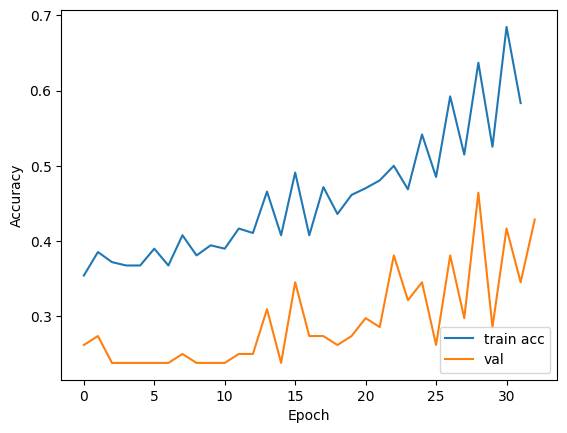

In [ ]:
# Accuracy
plt.plot(history.history['accuracy'][1:], label='train acc')
plt.plot(history.history['val_accuracy'], label='val')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

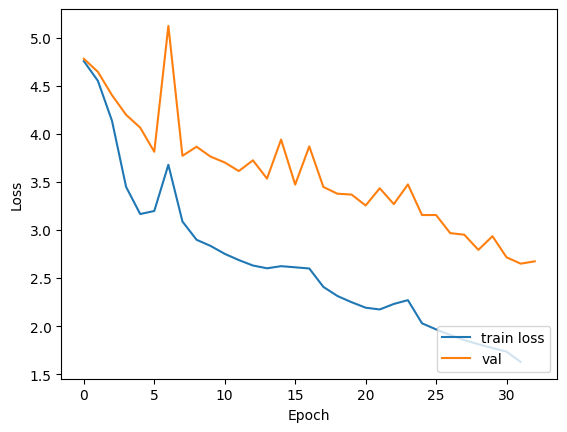

In [ ]:
# Loss
plt.plot(history.history['loss'][1:], label='train loss')
plt.plot(history.history['val_loss'], label='val')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='lower right')

##Interference

In [ ]:
# Next, let’s build the dictionary to convert the index to word for target and source vocabulary:
reverse_target_word_index = y_tokenizer.index_word
reverse_source_word_index = x_tokenizer.index_word
target_word_index = y_tokenizer.word_index

In [ ]:
def build_seq2seq_model_with_just_lstm_inference(
    max_text_len, latent_dim, encoder_input, encoder_output,
    encoder_final_states, decoder_input, decoder_output,
    decoder_embedding_layer, decoder_dense, last_decoder_lstm
):
    # Encode the input sequence to get the feature vector
    encoder_model = Model(
        inputs=encoder_input, outputs=[encoder_output] + encoder_final_states
    )

    # Decoder setup
    # Below tensors will hold the states of the previous time step
    decoder_state_input_h = Input(shape=(latent_dim, ))
    decoder_state_input_c = Input(shape=(latent_dim, ))
    decoder_hidden_state_input = Input(shape=(max_text_len, latent_dim))

    # Get the embeddings of the decoder sequence
    decoder_embedding = decoder_embedding_layer(decoder_input)

    # To predict the next word in the sequence, set the initial
    # states to the states from the previous time step
    decoder_output, *decoder_states = last_decoder_lstm(
        decoder_embedding,
        initial_state=[decoder_state_input_h, decoder_state_input_c]
    )

    # A dense softmax layer to generate prob dist. over the target vocabulary
    decoder_output = decoder_dense(decoder_output)

    # Final decoder model
    decoder_model = Model(
        [decoder_input] + [decoder_hidden_state_input, decoder_state_input_h, decoder_state_input_c],
        [decoder_output] + decoder_states
    )

    return (encoder_model, decoder_model)

In [ ]:
encoder_model, decoder_model = build_seq2seq_model_with_just_lstm_inference(
    max_text_len, latent_dim, encoder_input, encoder_output,
    encoder_final_states, decoder_input, decoder_output,
    decoder_embedding_layer, decoder_dense, last_decoder_lstm
)

In [ ]:
encoder_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 42)]              0         
                                                                 
 embedding (Embedding)       (None, 42, 300)           152400    
                                                                 
 lstm (LSTM)                 [(None, 42, 240),         519360    
                              (None, 240),                       
                              (None, 240)]                       
                                                                 
 lstm_1 (LSTM)               [(None, 42, 240),         461760    
                              (None, 240),                       
                              (None, 240)]                       
                                                                 
Total params: 1,133,520
Trainable params: 981,120
Non-train

In [ ]:
decoder_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 embedding_1 (Embedding)        (None, None, 300)    41100       ['input_2[0][0]']                
                                                                                                  
 input_3 (InputLayer)           [(None, 240)]        0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 240)]        0           []                               
                                                                                            

In [ ]:
decoder_model.layers[-3].input

[<KerasTensor: shape=(None, None, 300) dtype=float32 (created by layer 'embedding_1')>,
 <KerasTensor: shape=(None, 240) dtype=float32 (created by layer 'lstm_1')>,
 <KerasTensor: shape=(None, 240) dtype=float32 (created by layer 'lstm_1')>]

In [ ]:
def decode_sequence_seq2seq_model_with_just_lstm(
    input_sequence, encoder_model, decoder_model
):
    # Encode the input as state vectors.
    e_out, e_h, e_c = encoder_model.predict(input_sequence)

    # Generate empty target sequence of length 1.
    target_seq = np.zeros((1, 1))

    # Populate the first word of target sequence with the start word.
    target_seq[0, 0] = target_word_index[start_token]

    stop_condition = False
    decoded_sentence = ''

    while not stop_condition:
        output_tokens, h, c = decoder_model.predict(
            [target_seq] + [e_out, e_h, e_c]
        )

        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_token = reverse_target_word_index[sampled_token_index]

        if sampled_token != end_token:
            decoded_sentence += ' ' + sampled_token

        # Exit condition: either hit max length or find stop word.
        if (sampled_token == end_token) or (len(decoded_sentence.split()) >= (max_summary_len - 1)):
            stop_condition = True

        # Update the target sequence (of length 1).
        target_seq = np.zeros((1, 1))
        target_seq[0, 0] = sampled_token_index

        # Update internal states
        e_h, e_c = h, c

    return decoded_sentence

In [ ]:
def seq2summary(input_sequence):
    new_string = ''
    for i in input_sequence:
        if (
            (i != 0 and i != target_word_index[start_token]) and
            (i != target_word_index[end_token])
        ):
            new_string = new_string + reverse_target_word_index[i] + ' '
    return new_string

In [ ]:
def seq2text(input_sequence):
    new_string = ''
    for i in input_sequence:
        if i != 0:
            new_string = new_string + reverse_source_word_index[i] + ' '
    return new_string

In [ ]:
l = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

if len(l) % 3 != 0:
    while len(l) % 3 != 0:
        l.append(0)
print(l)

lst_i = 3
for i in range(0, len(l), 3):
    print(l[i:i + lst_i])

print(' '.join(['', 'james', 'ethan', '', 'tony']))
print(' '.join(' '.join(['', 'james', 'ethan', '', 'tony']).split()))

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 0, 0]
[1, 2, 3]
[4, 5, 6]
[7, 8, 9]
[10, 0, 0]
 james ethan  tony
james ethan tony


In [ ]:
def predict_text(text, decode_sequence, encoder_model, decoder_model):
    original_text = text
    text = clean_text([text])  # generator
    text_list = original_text.split()

    if len(text_list) <= max_text_len:
        text = expand_contractions(text)
        text = clean_text(text)
        text = f'_START_ {text} _END_'
        text = f'{start_token} {text} {end_token}'

        seq = x_tokenizer.texts_to_sequences([' '.join(text_list)])
        padded = pad_sequences(seq, maxlen=max_text_len, padding='post')
        pred_summary = decode_sequence(
            padded.reshape(1, max_text_len), encoder_model, decoder_model
        )
        return pred_summary
    else:
        pred_summary = ''

        # breaking long texts to individual max_text_len texts and predicting on them
        while len(text_list) % max_text_len == 0:
            text_list.append('')

        lst_i = max_text_len
        for i in range(0, len(text_list), max_text_len):
            _text_list = original_text.split()[i:i + lst_i]
            _text = ' '.join(_text_list)
            _text = ' '.join(
                _text.split()
            )  # to remove spaces that were added to make len(text_list) % max_text_len == 0

            _text = expand_contractions(_text)
            _text = clean_text(_text)  # generator
            _text = f'_START_ {_text} _END_'
            _text = f'{start_token} {_text} {end_token}'
            # print(_text, '\n')

            _seq = x_tokenizer.texts_to_sequences([_text])
            _padded = pad_sequences(_seq, maxlen=max_text_len, padding='post')
            _pred = decode_sequence(
                _padded.reshape(1, max_text_len), encoder_model, decoder_model
            )
            pred_summary += ' ' + ' '.join(_pred.split()[1:-2])
            pred_summary = ' '.join(pred_summary.split())

        return pred_summary

In [ ]:
!pip install Rouge

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from rouge import Rouge
r=Rouge()

In [ ]:
k,news_=[],[]
# Testing on training data
c=0
for i in range(0, 30):
    z=seq2text(x_train_padded[i])
    ref=seq2summary(y_train_padded[i])
    try:
      hypo=decode_sequence_seq2seq_model_with_just_lstm(
            x_train_padded[i].reshape(1, max_text_len), encoder_model,
            decoder_model)
    except:
      continue
    f1,f2=True,True
    if z in news_:
      f1=False
    for j in k:
      if ref in j[0] or hypo in j[1]:
        f2=False
    if ((not f1) and (not f2)) or (not ref or not hypo):
      continue
    news_.append(z)
    #heading=check(z)
    #print(f"# {i+1} {heading}: ",z )
    #print("case:{}".format(i+1))
    print("Original summary: ",ref )
    print("Predicted summary: ",hypo)
    g=r.get_scores(ref,hypo)
    print(g)
    k.append([ref,hypo])
    #img_ids=get_img_id(hypo)
    #for j in img_ids:
      #print_img(data["ImgId"][j])
    #print_img(data["ImgId"][img_ids])
    print()

1/1 [==============================] - 0s 38ms/step
Original summary:  police say uk us involved crash tongariro forest park new zealand 
Predicted summary:   police police alerted us us us involved crash tongariro forest park new
[{'rouge-1': {'r': 0.8888888888888888, 'p': 0.7272727272727273, 'f': 0.79999999505}, 'rouge-2': {'r': 0.6, 'p': 0.6, 'f': 0.5999999950000001}, 'rouge-l': {'r': 0.8888888888888888, 'p': 0.7272727272727273, 'f': 0.79999999505}}]

1/1 [==============================] - 0s 39ms/step
Original summary:  elderly man charged murder yearold partner 
Predicted summary:   man man man charged yearold
[{'rouge-1': {'r': 1.0, 'p': 0.5, 'f': 0.6666666622222223}, 'rouge-2': {'r': 0.3333333333333333, 'p': 0.2, 'f': 0.24999999531250006}, 'rouge-l': {'r': 1.0, 'p': 0.5, 'f': 0.6666666622222223}}]

1/1 [==============================] - 0s 47ms/step
Original summary:  man body found backyard south east melbourne 
Predicted summary:   man man man charged murder
[{'rouge-1': {'r':

In [ ]:
hyps,refs="",""
for i in k:
  hyps+=i[0]
  refs+=i[1]
scores = r.get_scores(hyps, refs, avg=True)
scores

{'rouge-1': {'r': 1.0, 'p': 0.3181818181818182, 'f': 0.48275861702734846},
 'rouge-2': {'r': 0.4909090909090909,
  'p': 0.23684210526315788,
  'f': 0.31952662282833233},
 'rouge-l': {'r': 0.9428571428571428, 'p': 0.3, 'f': 0.45517241013079673}}

In [17]:
import pandas as pd
data=pd.read_csv("/content/drive/MyDrive/finaldata.csv")
print(len(data))
data

44007


,@body,@summary,ImgId,captions
0,Five years ago Giuliana Rancic had a double ma...,In 2012 she had a double mastectomy as she bat...,0713a5ab7a737e24b707429aefb146d5a3078352_8.jpg,A bit of all white: The majestic mountain rang...
1,Genetically-modified cows are being bred witho...,Scientists have created the cows to protect fa...,0676abd33c00d6125ee6f76ee720059b4f7e1a2f_36.jpg,"In this picture, Johnson captures a picnic fro..."
2,She carved out a role as a pathbreaking profes...,Ivanka Trump was a constant presence at her fa...,07718b270474c434797892ceca03ea2aeb9d6b39_4.jpg,"Felgate (pictured, left, in 2007) is best know..."
3,A couple who made # 1million from cocaine blew...,Carl and Donna Honey-Jones used drug dealing e...,0ced9a16e57f981a25e6e5ce7fe4a3cf022301f6_4.jpg,"Clancey's Hotel&nbsp;features 10 bedrooms, a n..."
4,Though he did n't come dressed as a scary curs...,"Joel Lynch , an Iowa State University senior ,...",162eaba8c80eea53ffb5b17b2c6e641a7a3fd7a9_10.jpg,Tractors with snowploughs are being used in a ...
...,...,...,...,...
44002,It was once the largest and wealthiest city in...,Pictures taken in 1809s in Constantinople have...,img,cap
44003,West Ham vice-chairman Karren Brady insists sh...,West Ham vice-chairman Karren Brady shares the...,img,cap
44004,The echoes of demonetisation rang through an N...,Mujahid is accused of arranging meetings and i...,img,cap
44005,The mother of a serial killer who stabbed thre...,Joanna Dennehy stabbed three men to death befo...,img,cap


In [ ]:
data["@summary"][0]

'In 2012 she had a double mastectomy as she battled breast cancer\n\n\n'

In [19]:
from google.colab.patches import cv2_imshow

In [ ]:
y=[]

In [ ]:
'''s=input().split(',')
print(s)
h=[]
for i in range(len(s)):
  k=s[i].split()
  for i in k:
    if i not in y:
      h.append(i)
      y.append(i)
print(h)'''

"s=input().split(',')\nprint(s)\nh=[]\nfor i in range(len(s)):\n  k=s[i].split()\n  for i in k:\n    if i not in y:\n      h.append(i)\n      y.append(i)\nprint(h)"

In [ ]:
'''with open("/content/drive/MyDrive/MSMODATASET/headings_data.pickle","rb") as f:
  headings=pickle.load(f)'''

'with open("/content/drive/MyDrive/MSMODATASET/headings_data.pickle","rb") as f:\n  headings=pickle.load(f)'

In [ ]:
#headings.keys()

In [ ]:
'''def check(s):
  s=s.split()
  s=set(s)
  c,p=0,0
  f=False
  for key,value in headings.items():
    s2=set(value)
    if len(s&s2)>c:
      f=True
      c=len(s&s2)
      k=key
      ind=p
    p+=1
  if not f:
    return "News (topic-12)"
  return k+"(topic-"+str(p)+")"'''

'def check(s):\n  s=s.split()\n  s=set(s)\n  c,p=0,0\n  f=False\n  for key,value in headings.items():\n    s2=set(value)\n    if len(s&s2)>c:\n      f=True\n      c=len(s&s2)\n      k=key\n      ind=p\n    p+=1\n  if not f:\n    return "News (topic-12)"\n  return k+"(topic-"+str(p)+")"'

In [ ]:
'''k,news_=[],[]
# Testing on training data
for i in range(0, 30):
    z=seq2text(x_train_padded[i])
    ref=seq2summary(y_train_padded[i])
    hypo=decode_sequence_seq2seq_model_with_just_lstm(
            x_train_padded[i].reshape(1, max_text_len), encoder_model,
            decoder_model)
    f1,f2=True,True
    if z in news_:
      f1=False
    for j in k:
      if ref in j[0] or hypo in j[1]:
        f2=False
    if (not f1) and (not f2):
      continue
    news_.append(z)
    #heading=check(z)
    #print(f"# {i+1} {heading}: ",z )
    print("Original summary: ",ref )
    print("Predicted summary: ",hypo)
    g=r.get_scores(ref,hypo)
    print(g)
    k.append([ref,hypo])
    #img_ids=get_img_id(hypo)
    #for j in img_ids:
      #print_img(data["ImgId"][j])
    #print_img(data["ImgId"][img_ids])
    print()'''

'k,news_=[],[]\n# Testing on training data\nfor i in range(0, 30):\n    z=seq2text(x_train_padded[i])\n    ref=seq2summary(y_train_padded[i])\n    hypo=decode_sequence_seq2seq_model_with_just_lstm(\n            x_train_padded[i].reshape(1, max_text_len), encoder_model,\n            decoder_model)\n    f1,f2=True,True\n    if z in news_:\n      f1=False\n    for j in k:\n      if ref in j[0] or hypo in j[1]:\n        f2=False\n    if (not f1) and (not f2):\n      continue\n    news_.append(z)\n    #heading=check(z)\n    #print(f"# {i+1} {heading}: ",z )\n    print("Original summary: ",ref )\n    print("Predicted summary: ",hypo)\n    g=r.get_scores(ref,hypo)\n    print(g)\n    k.append([ref,hypo])\n    #img_ids=get_img_id(hypo)\n    #for j in img_ids:\n      #print_img(data["ImgId"][j])\n    #print_img(data["ImgId"][img_ids])\n    print()'

In [ ]:
#news_[14]

In [ ]:
#data["ImgId"][8624]

In [ ]:
'''while True:
  print(0,end="") '''

'while True:\n  print(0,end="") '

In [ ]:
hyps,refs="",""
for i in k:
  hyps+=i[0]
  refs+=i[1]

In [ ]:
hyps,refs="",""
for i in k:
  hyps+=i[0]
  refs+=i[1]
scores = r.get_scores(hyps,refs,avg=True)
scores

{'rouge-1': {'r': 0.5231818181818182,
  'p': 0.3181818181818182,
  'f': 0.48275861702734846},
 'rouge-2': {'r': 0.3360909090909091,
  'p': 0.23684210526315788,
  'f': 0.31952662282833233},
 'rouge-l': {'r': 0.45372727272727276, 'p': 0.3, 'f': 0.45517241013079673}}

In [ ]:
#Bleu scores
import nltk
from nltk.translate.bleu_score import sentence_bleu
c=0
for i in k:
  ref=[i[1].split()]
  pre=i[0].split()
  score=sentence_bleu(ref,pre)
  #print(c,":")
  print(score)
  c+=1

0.5387722220470361
8.38826642100846e-155
1.1200407237786664e-231
0
0
0.7071067811865475
0
0
0
5.072841446586652e-78
1.821831989445342e-231
6.86809206056511e-78
0
5.396466934950335e-155
0
0.668740304976422
0


/usr/local/lib/python3.9/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.9/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.9/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg

In [ ]:
#Avg Blue Score
score2=sentence_bleu(refs,hyps)
print(score2)

7.485518687031807e-232


In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
import re
def remove_extra(l):
  l=re.sub(r"[^a-zA-Z]"," ",l)
  return l

In [ ]:
s=data["captions"][3].lower()
print(s)
print(remove_extra(s))

clancey's hotel&nbsp;features 10 bedrooms, a newly renovated kitchen, games room and outside beer garden another pub for sale in nsw is the tattersall's hotel in baradine (pictured) and the asking price $340,000 in the north queensland town of mirani is the very distinguishable blue and yellow mirani hotel (pictured) currently on the market for $245,000 the newly renovated wakefield hotel, in adelaide (pictured) is currently on the market for $260,000 this 1920s tattersall hotel (pictured) features a new commercial kitchen, 10 room accommodation, pokie and pool rooms, formal dining room and covered outdoor area the recently refurbished wakefiled hotel houses 20 gaming machines, up to seven function areas and has outdoor dining doodle cooma arms hotel in henty, nsw, (pictured) is currently on sale for&nbsp;offers of more than $300,000 if investors are searching for cooler climates that the bischoff hotel in tasmania (pictured) could be just the place the two storey railway hotel (pictur

In [ ]:
def remove_extra_english(li):
  tokens = word_tokenize(li)
  tokenization = [word for word in tokens if not word in stopwords.words('english')]
  return tokenization

In [ ]:
def solve(s0, s1):
      s0List = remove_extra(s0.lower())
      s0List=remove_extra_english(s0List)
      s1List = remove_extra(s1.lower())
      s1List=remove_extra_english(s1List)
      return len(list(set(s0List)&set(s1List)))

In [ ]:
'''def get_img_id(hypo):
  cap_ind,c=0,0
  l=[]
  a=hypo
  s1=remove_extra(a.lower())
  s1=remove_extra_english(s1)
  for j in range(8625):
    b=data["captions"][j]
    #print(type(a),type(b),j)
    s2=remove_extra(b.lower())
    s2=remove_extra_english(s2)
    v=len(set(s1)&set(s2))
    if v>c:
      c=v
      cap_ind=j
      l.append(cap_ind)
  #print(s1)
  #print(s2)
  print(f" Number of matchings:{c}",end=" ")
  print(f" ImgId:{cap_ind}")
  return cap_ind'''

'def get_img_id(hypo):\n  cap_ind,c=0,0\n  l=[]\n  a=hypo\n  s1=remove_extra(a.lower())\n  s1=remove_extra_english(s1)\n  for j in range(8625):\n    b=data["captions"][j]\n    #print(type(a),type(b),j)\n    s2=remove_extra(b.lower())\n    s2=remove_extra_english(s2)\n    v=len(set(s1)&set(s2))\n    if v>c:\n      c=v\n      cap_ind=j\n      l.append(cap_ind)\n  #print(s1)\n  #print(s2)\n  print(f" Number of matchings:{c}",end=" ")\n  print(f" ImgId:{cap_ind}")\n  return cap_ind'

In [ ]:
import nltk
nltk.download('punkt')
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
# Cosine similarity
def co_sim(hyp):
  c=0.0000000000000001
  ind=-1
  summary=hyp
  img_ids,cosine_values=[],[]
  for i in range(8625):
    caption=data['captions'][i]
    caption_tokens = nltk.word_tokenize(caption.lower())
    summary_tokens = nltk.word_tokenize(summary.lower())
    vectorizer = CountVectorizer()
    caption_vector = vectorizer.fit_transform([caption]).toarray()
    summary_vector = vectorizer.transform([summary]).toarray()
    # Calculate cosine similarity between the vectors
    similarity_score = cosine_similarity(caption_vector, summary_vector)
    if similarity_score[0][0]>=c:
      c=similarity_score[0][0]
      ind=i
      img_ids.append(ind)
      cosine_values.append(c)
  return c,ind,img_ids,cosine_values

In [ ]:
# Recall@1

import nltk
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import pairwise_distances

def recall_k(hyp):
  summary=hyp
  ind=-1
  c=0
  for i in range(8625):
    caption=data['captions'][i]
    caption_tokens = nltk.word_tokenize(caption.lower())
    summary_tokens = nltk.word_tokenize(summary.lower())
    vectorizer = CountVectorizer()
    caption_vector = vectorizer.fit_transform([caption]).toarray()
    summary_vector = vectorizer.transform([summary]).toarray()
    distances = pairwise_distances(caption_vector, summary_vector, metric='cosine')
    if distances[0][0]>c:
      c=distances[0][0]
      ind=i
  return c,ind

In [15]:
import cv2
def print_img(id_):
  path="/content/img"
  img=cv2.imread(path+"/"+id_)
  ims = cv2.resize(img, (300, 300))
  cv2_imshow(ims)
  cv2.waitKey(2000)

In [ ]:
'''def get_img_id(l,s):
  c=0
  d={}
  s=s.split()
  for i in l:
    k=data["captions"][i]
    k=k.split()
    le=
    d[len(set(k)&set(s))]=i
  return d[max(d)]'''

'def get_img_id(l,s):\n  c=0\n  d={}\n  s=s.split()\n  for i in l:\n    k=data["captions"][i]\n    k=k.split()\n    le=\n    d[len(set(k)&set(s))]=i\n  return d[max(d)]'

In [ ]:
resultants=[]

Original Summary: police say uk us involved crash tongariro forest park new zealand 
Predicted Summary  police police alerted us us us involved crash tongariro forest park new
[{'rouge-1': {'r': 0.8888888888888888, 'p': 0.7272727272727273, 'f': 0.79999999505}, 'rouge-2': {'r': 0.6, 'p': 0.6, 'f': 0.5999999950000001}, 'rouge-l': {'r': 0.8888888888888888, 'p': 0.7272727272727273, 'f': 0.79999999505}}]
Cosine similarity-->
Matched Images--->: 18
Matched with cosine similarity of: 0.006783413295938629


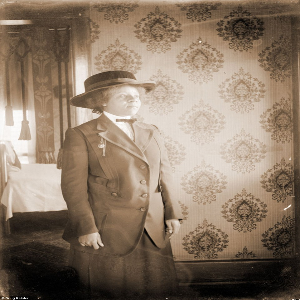


Matched with cosine similarity of: 0.06243905410544627


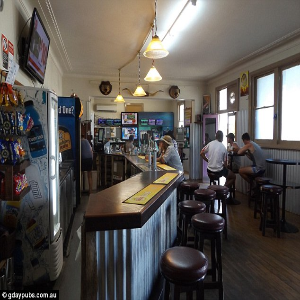


Matched with cosine similarity of: 0.0936585811581694


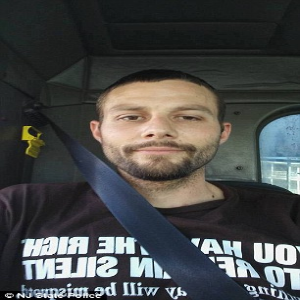


Matched with cosine similarity of: 0.11952286093343936


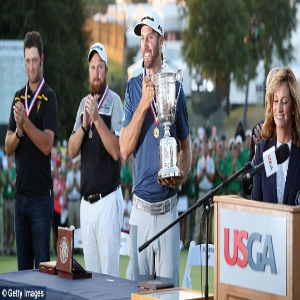


Matched with cosine similarity of: 0.13366037652862364


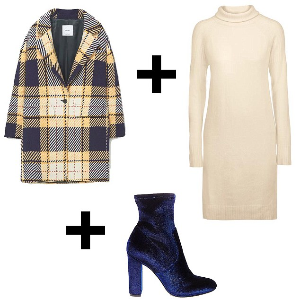


Matched with cosine similarity of: 0.16724840200141816


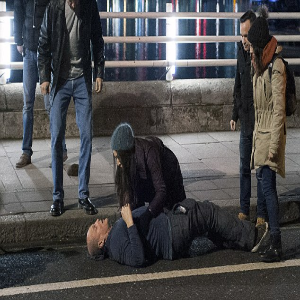


Matched with cosine similarity of: 0.19706585563285864


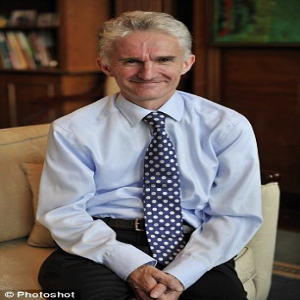


Matched with cosine similarity of: 0.19984019174435788


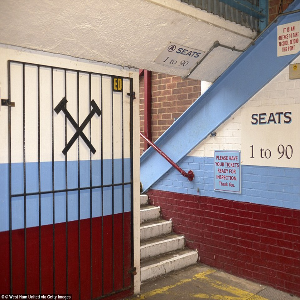


Matched with cosine similarity of: 0.23643312187173018


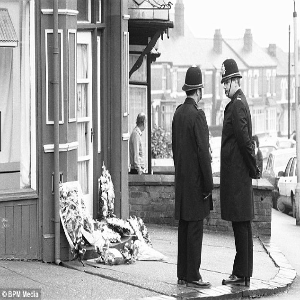


Matched with cosine similarity of: 0.25


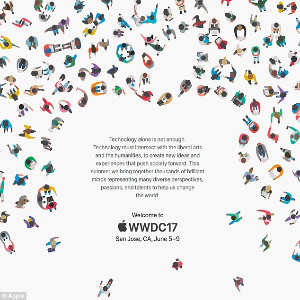


Matched with cosine similarity of: 0.29851115706299675


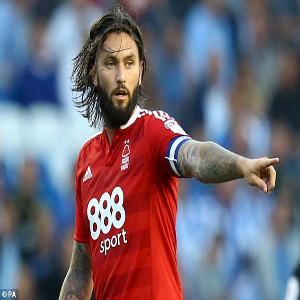


Matched with cosine similarity of: 0.314970394174356


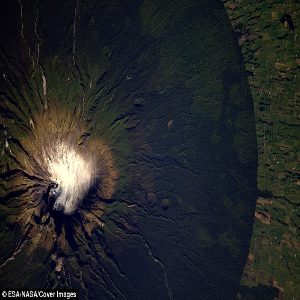


Matched with cosine similarity of: 0.3554093266554554


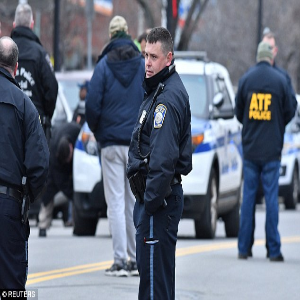


Matched with cosine similarity of: 0.3554093266554554


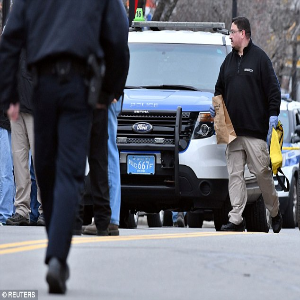


Matched with cosine similarity of: 0.3554093266554554


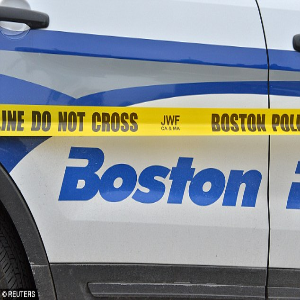


Matched with cosine similarity of: 0.3554093266554554


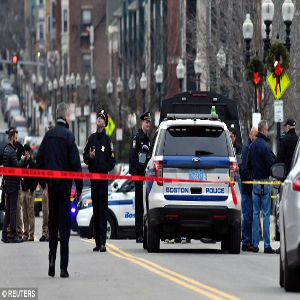


Matched with cosine similarity of: 0.3554093266554554


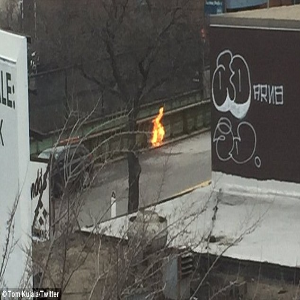


Matched with cosine similarity of: 0.3554093266554554


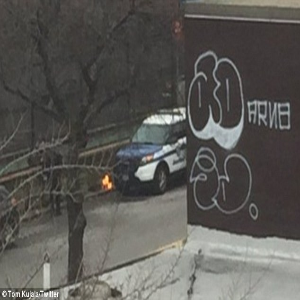


Releavent Image-->
Matched with cosine similarity of: 0.3554093266554554


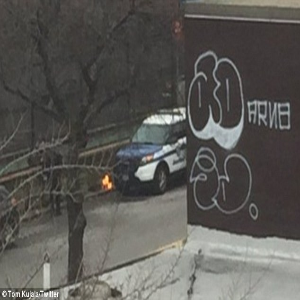


Original Summary: elderly man charged murder yearold partner 
Predicted Summary  man man man charged yearold
[{'rouge-1': {'r': 1.0, 'p': 0.5, 'f': 0.6666666622222223}, 'rouge-2': {'r': 0.3333333333333333, 'p': 0.2, 'f': 0.24999999531250006}, 'rouge-l': {'r': 1.0, 'p': 0.5, 'f': 0.6666666622222223}}]
Cosine similarity-->
Matched Images--->: 7
Matched with cosine similarity of: 0.0293730411932599


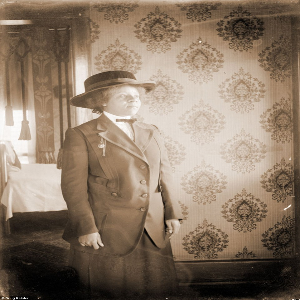


Matched with cosine similarity of: 0.20412414523193154


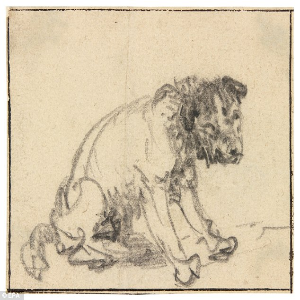


Matched with cosine similarity of: 0.3020610466650885


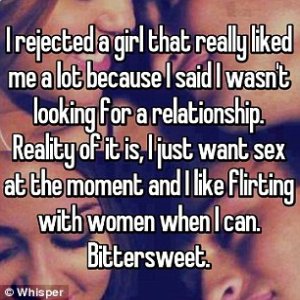


Matched with cosine similarity of: 0.3020610466650885


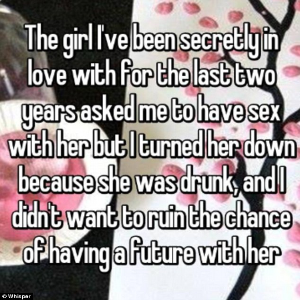


Matched with cosine similarity of: 0.31799936400190804


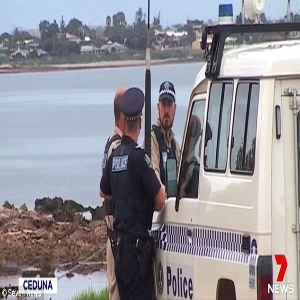


Matched with cosine similarity of: 0.31799936400190804


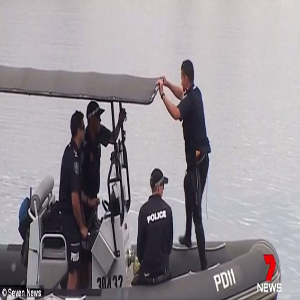


Matched with cosine similarity of: 0.31799936400190804


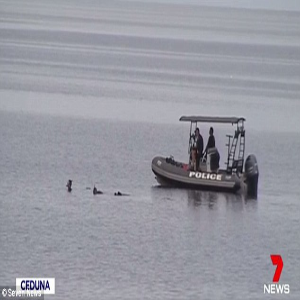


Releavent Image-->
Matched with cosine similarity of: 0.31799936400190804


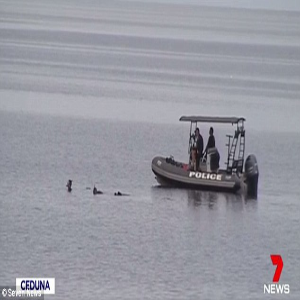


Original Summary: man body found backyard south east melbourne 
Predicted Summary  man man man charged murder
[{'rouge-1': {'r': 0.3333333333333333, 'p': 0.14285714285714285, 'f': 0.19999999580000008}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.3333333333333333, 'p': 0.14285714285714285, 'f': 0.19999999580000008}}]
Cosine similarity-->
Matched Images--->: 9
Matched with cosine similarity of: 0.025437799859769857


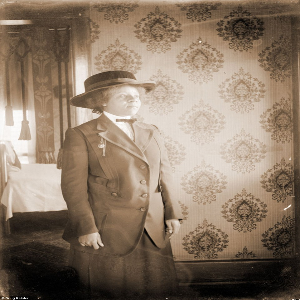


Matched with cosine similarity of: 0.031219527052723135


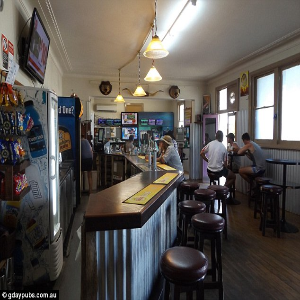


Matched with cosine similarity of: 0.20412414523193154


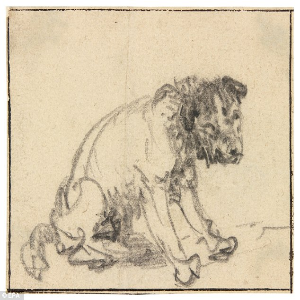


Matched with cosine similarity of: 0.3020610466650885


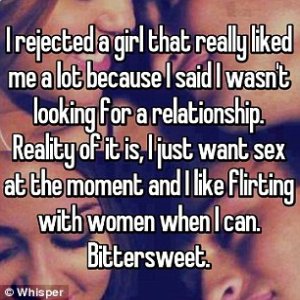


Matched with cosine similarity of: 0.3020610466650885


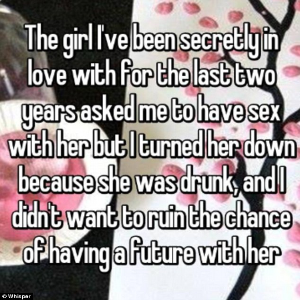


Matched with cosine similarity of: 0.3059950306810523


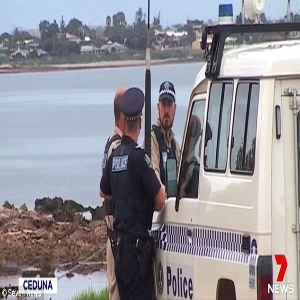


Matched with cosine similarity of: 0.3059950306810523


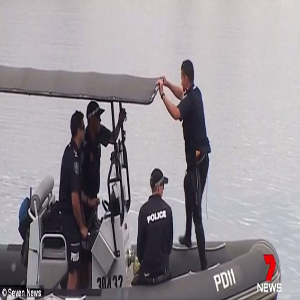


Matched with cosine similarity of: 0.3059950306810523


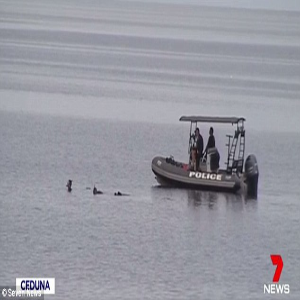


Matched with cosine similarity of: 0.31622776601683794


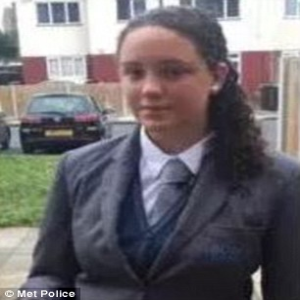


Releavent Image-->
Matched with cosine similarity of: 0.31622776601683794


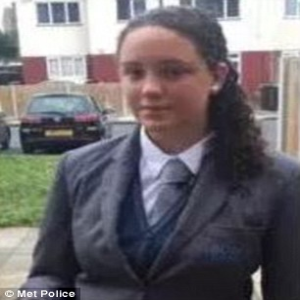


Original Summary: within minutes account accumulated million followers 
Predicted Summary  man man man found
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 8
Matched with cosine similarity of: 0.029656491293029667


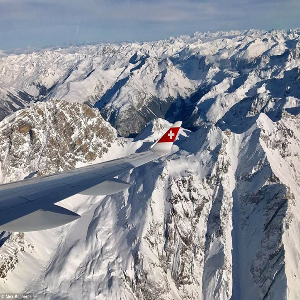


Matched with cosine similarity of: 0.04521000789084244


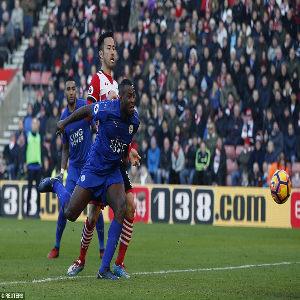


Matched with cosine similarity of: 0.09467621366623018


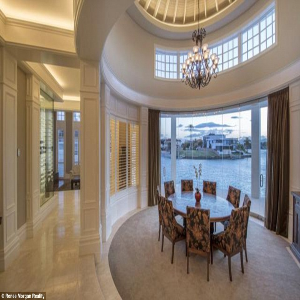


Matched with cosine similarity of: 0.10998533626601495


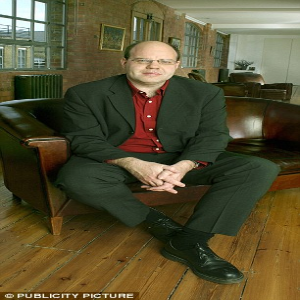


Matched with cosine similarity of: 0.1911541147877761


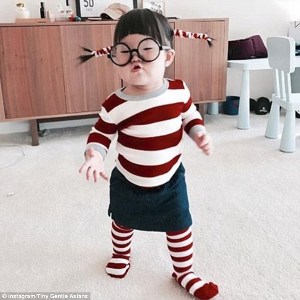


Matched with cosine similarity of: 0.1911541147877761


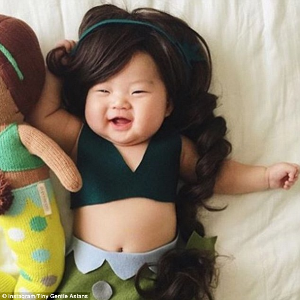


Matched with cosine similarity of: 0.21483446221182986


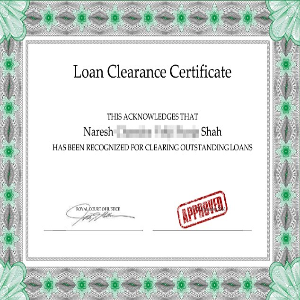


Matched with cosine similarity of: 0.2581988897471611


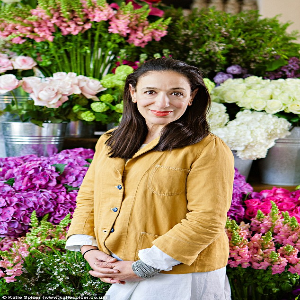


Releavent Image-->
Matched with cosine similarity of: 0.2581988897471611


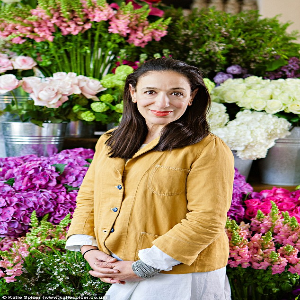


Original Summary: thomas jefferson hotel birmingham completed 
Predicted Summary  nan
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 6
Matched with cosine similarity of: 0.008307950644730349


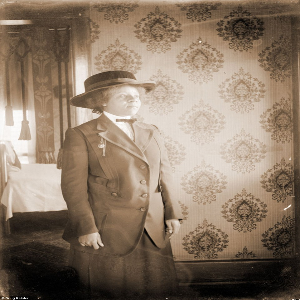


Matched with cosine similarity of: 0.37463432463267765


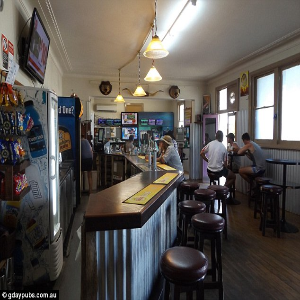


Matched with cosine similarity of: 0.37463432463267765


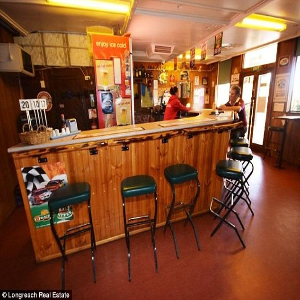


Matched with cosine similarity of: 0.37463432463267765


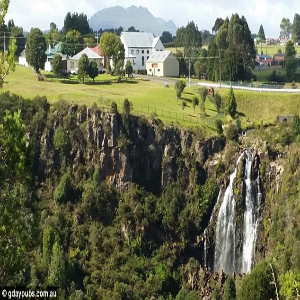


Matched with cosine similarity of: 0.3922322702763681


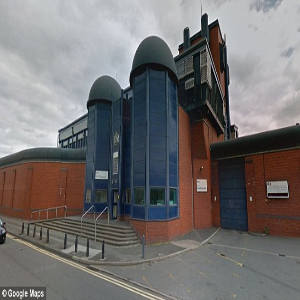


Matched with cosine similarity of: 0.3922322702763681


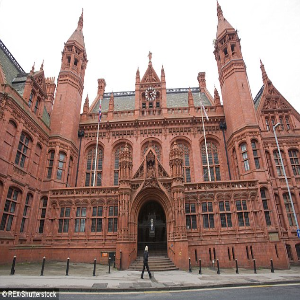


Releavent Image-->
Matched with cosine similarity of: 0.3922322702763681


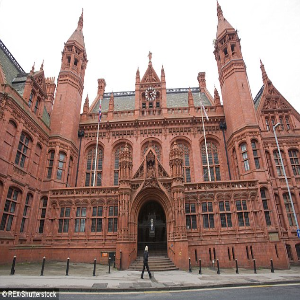


Original Summary: sofia hilary sported stylish swimwear beach holiday season 
Predicted Summary  sofia sported stylish swimwear beach holiday season
[{'rouge-1': {'r': 1.0, 'p': 0.875, 'f': 0.9333333283555556}, 'rouge-2': {'r': 0.8333333333333334, 'p': 0.7142857142857143, 'f': 0.7692307642603551}, 'rouge-l': {'r': 1.0, 'p': 0.875, 'f': 0.9333333283555556}}]
Cosine similarity-->
Matched Images--->: 8
Matched with cosine similarity of: 0.11503946170861015


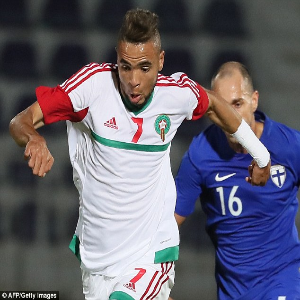


Matched with cosine similarity of: 0.15152288168283157


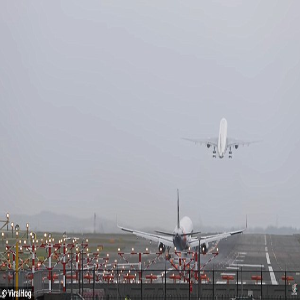


Matched with cosine similarity of: 0.1598721533954863


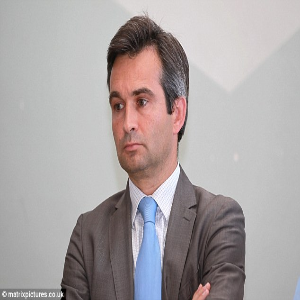


Matched with cosine similarity of: 0.29981267559834457


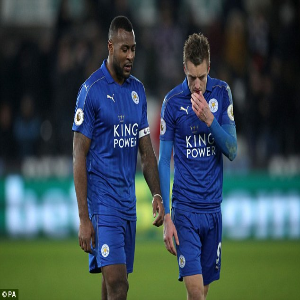


Matched with cosine similarity of: 0.29981267559834457


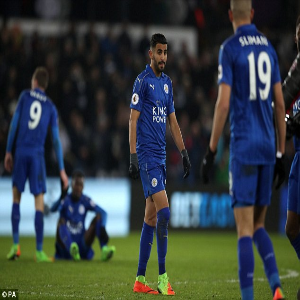


Matched with cosine similarity of: 0.29981267559834457


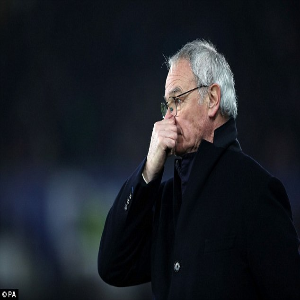


Matched with cosine similarity of: 0.29981267559834457


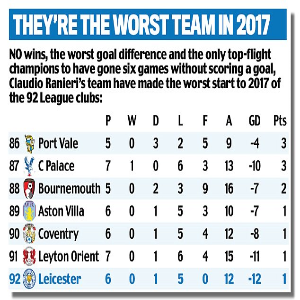


Matched with cosine similarity of: 0.29981267559834457


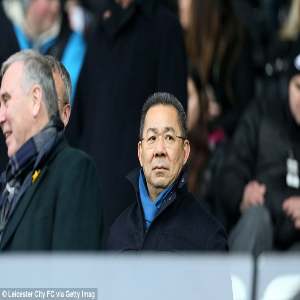


Releavent Image-->
Matched with cosine similarity of: 0.29981267559834457


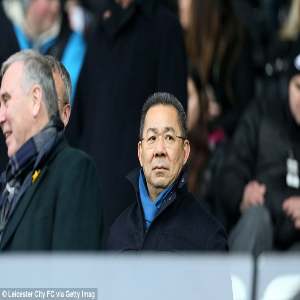


Original Summary: dakar rally winding way across miles three countries south america 
Predicted Summary  police police uk us involved crash tongariro forest park new
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 13
Matched with cosine similarity of: 0.01695853323984657


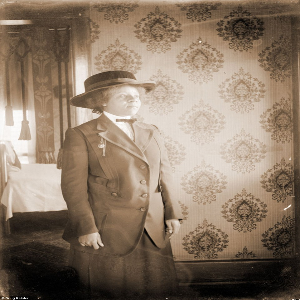


Matched with cosine similarity of: 0.031219527052723135


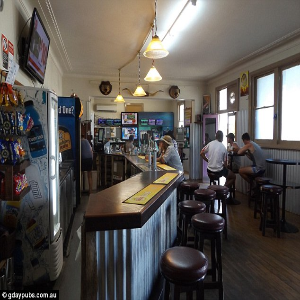


Matched with cosine similarity of: 0.03912082215097292


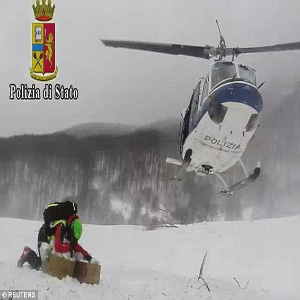


Matched with cosine similarity of: 0.04099600308453939


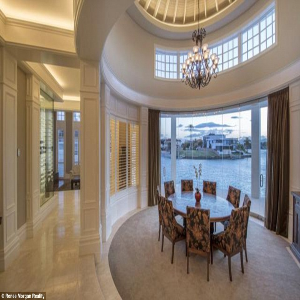


Matched with cosine similarity of: 0.1480385305614425


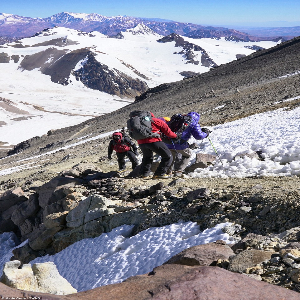


Matched with cosine similarity of: 0.17285002893384438


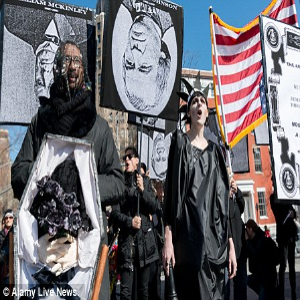


Matched with cosine similarity of: 0.21107926341908756


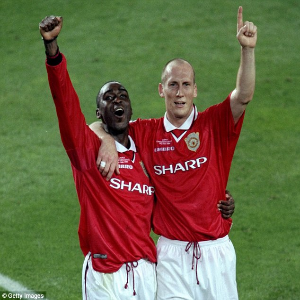


Matched with cosine similarity of: 0.2147312508380076


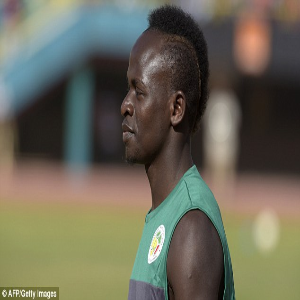


Matched with cosine similarity of: 0.2147312508380076


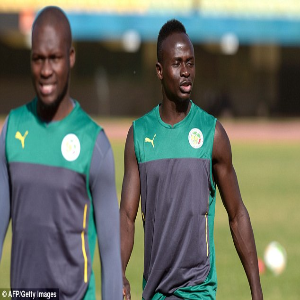


Matched with cosine similarity of: 0.2147312508380076


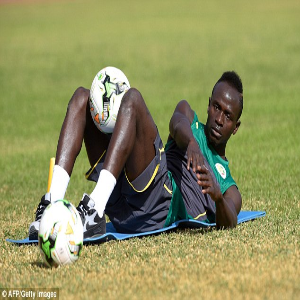


Matched with cosine similarity of: 0.26111648393354675


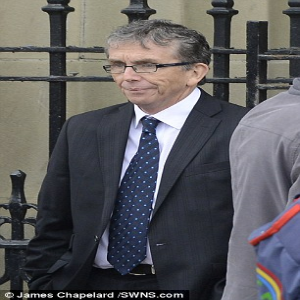


Matched with cosine similarity of: 0.26111648393354675


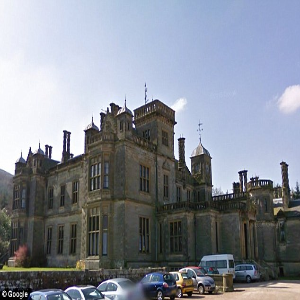


Matched with cosine similarity of: 0.26111648393354675


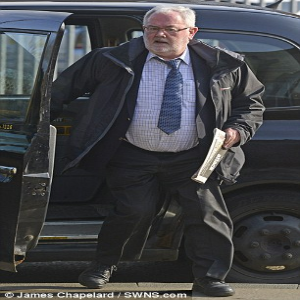


Releavent Image-->
Matched with cosine similarity of: 0.26111648393354675


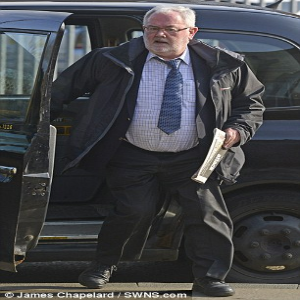


Original Summary: parents taken whisper reveal oddest rules make 
Predicted Summary  collection imgur imgur imgur
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 10
Matched with cosine similarity of: 0.01174921647730396


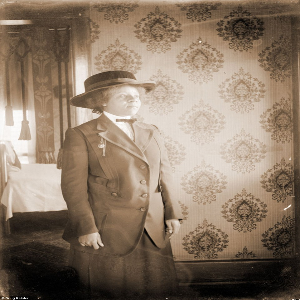


Matched with cosine similarity of: 0.028759865427152538


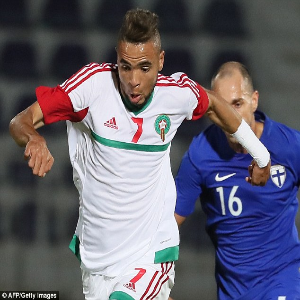


Matched with cosine similarity of: 0.09654740772724871


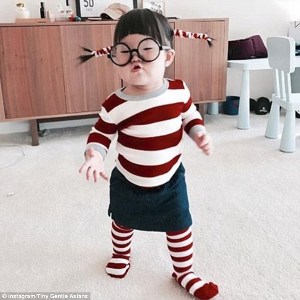


Matched with cosine similarity of: 0.10660035817780521


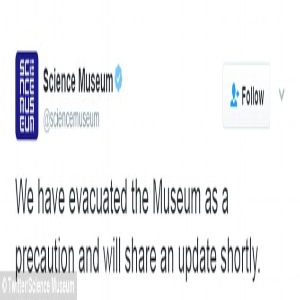


Matched with cosine similarity of: 0.14744195615489714


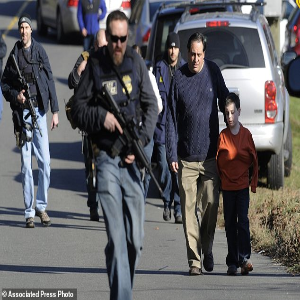


Matched with cosine similarity of: 0.19819149595051527


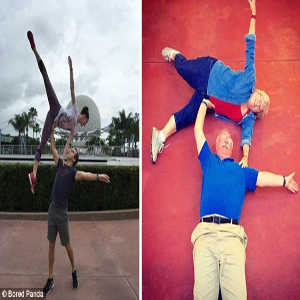


Matched with cosine similarity of: 0.19819149595051527


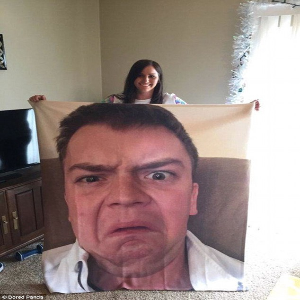


Matched with cosine similarity of: 0.22645540682891913


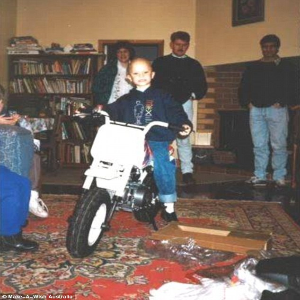


Matched with cosine similarity of: 0.22645540682891913


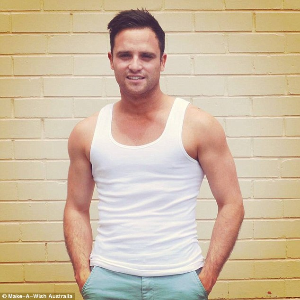


Matched with cosine similarity of: 0.22645540682891913


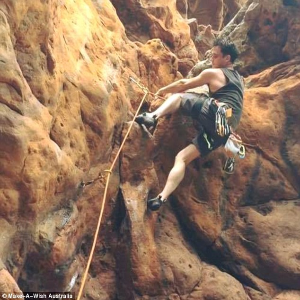


Releavent Image-->
Matched with cosine similarity of: 0.22645540682891913


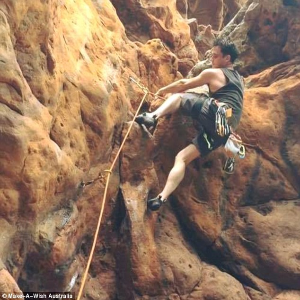


Original Summary: pictures show two male lions thought brothers attack kill buffalo 
Predicted Summary  police uk us involved involved
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 10
Matched with cosine similarity of: 0.029656491293029667


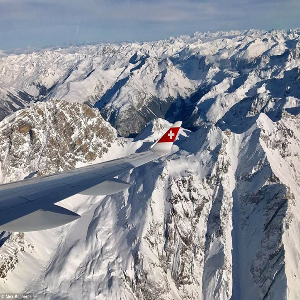


Matched with cosine similarity of: 0.031219527052723135


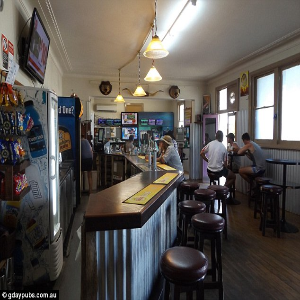


Matched with cosine similarity of: 0.0936585811581694


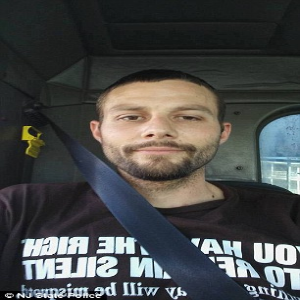


Matched with cosine similarity of: 0.15617376188860607


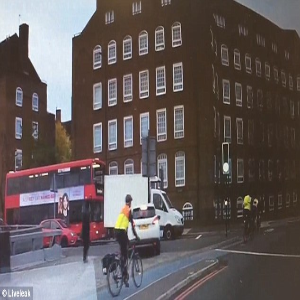


Matched with cosine similarity of: 0.2730773068396801


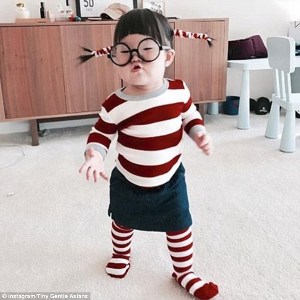


Matched with cosine similarity of: 0.3333333333333333


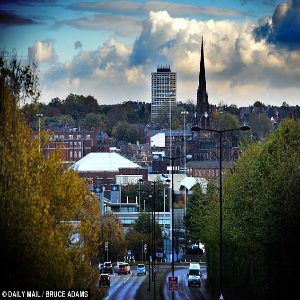


Matched with cosine similarity of: 0.3333333333333333


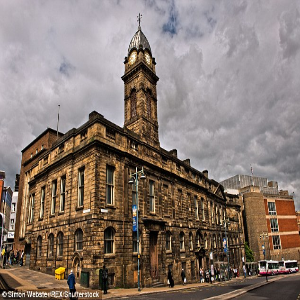


Matched with cosine similarity of: 0.40201512610368484


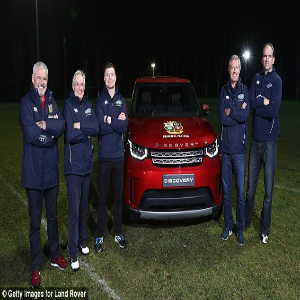


Matched with cosine similarity of: 0.40201512610368484


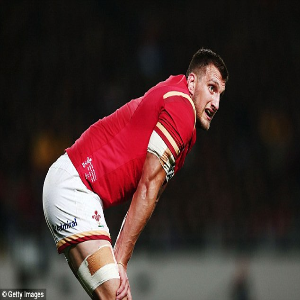


Matched with cosine similarity of: 0.40201512610368484


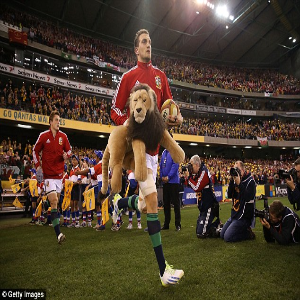


Releavent Image-->
Matched with cosine similarity of: 0.40201512610368484


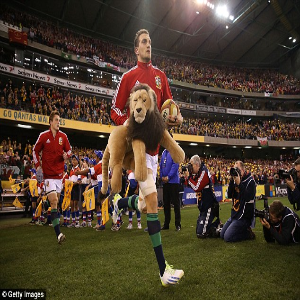


Original Summary: riley alessandra found perfect fashion formula rock winter long 
Predicted Summary  riley alessandra perfect perfect fashion formula
[{'rouge-1': {'r': 1.0, 'p': 0.5555555555555556, 'f': 0.7142857096938776}, 'rouge-2': {'r': 0.6, 'p': 0.375, 'f': 0.4615384568047337}, 'rouge-l': {'r': 1.0, 'p': 0.5555555555555556, 'f': 0.7142857096938776}}]
Cosine similarity-->
Matched Images--->: 13
Matched with cosine similarity of: 0.004153975322365174


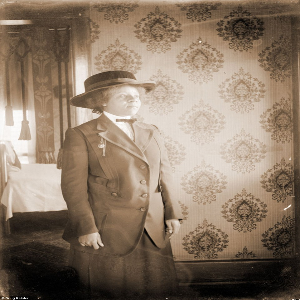


Matched with cosine similarity of: 0.04794633014853841


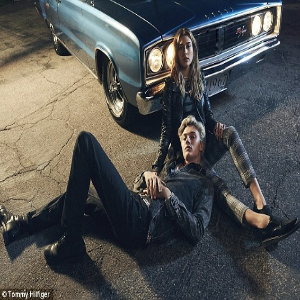


Matched with cosine similarity of: 0.0607456739230787


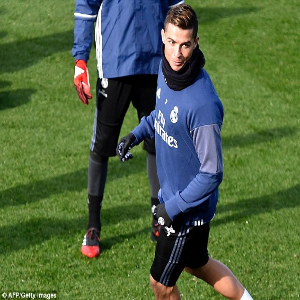


Matched with cosine similarity of: 0.07720515968416367


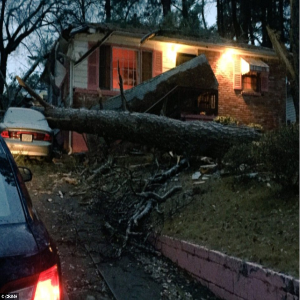


Matched with cosine similarity of: 0.08362420100070908


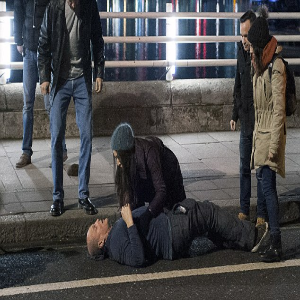


Matched with cosine similarity of: 0.09932685831612643


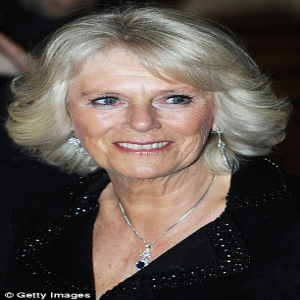


Matched with cosine similarity of: 0.11322770341445956


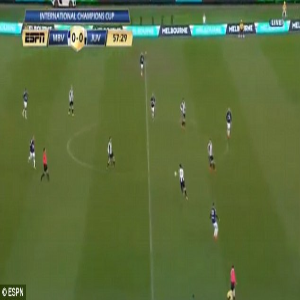


Matched with cosine similarity of: 0.1796053020267749


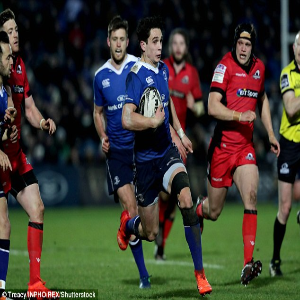


Matched with cosine similarity of: 0.18325416653445784


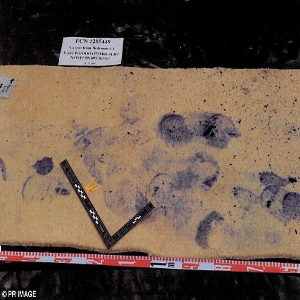


Matched with cosine similarity of: 0.24413653763134782


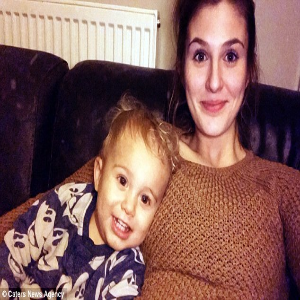


Matched with cosine similarity of: 0.30151134457776363


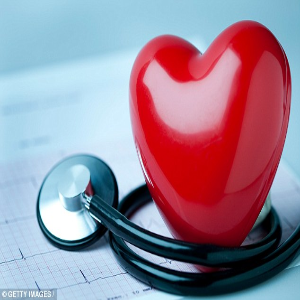


Matched with cosine similarity of: 0.30151134457776363


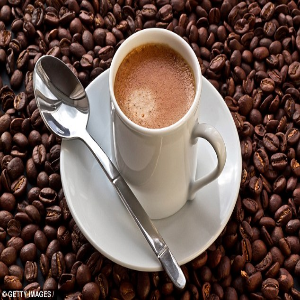


Matched with cosine similarity of: 0.31622776601683794


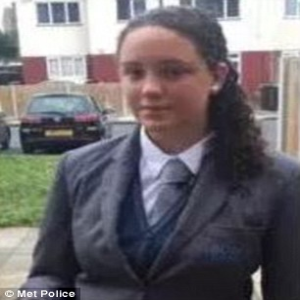


Releavent Image-->
Matched with cosine similarity of: 0.31622776601683794


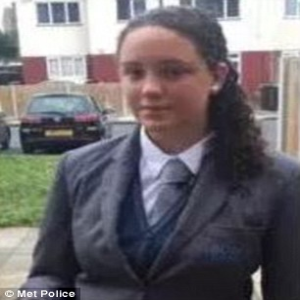


Original Summary: nan 
Predicted Summary  nan
[{'rouge-1': {'r': 1.0, 'p': 1.0, 'f': 0.999999995}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 1.0, 'p': 1.0, 'f': 0.999999995}}]
Cosine similarity-->
Matched Images--->: 5
Matched with cosine similarity of: 0.1270001270001905


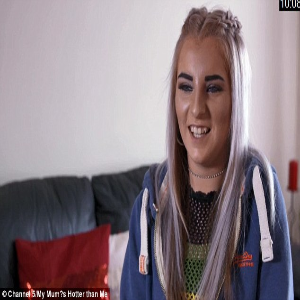


Matched with cosine similarity of: 0.1270001270001905


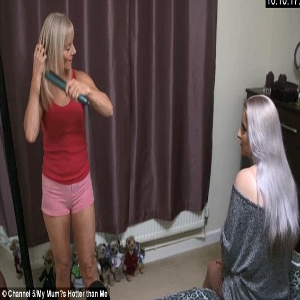


Matched with cosine similarity of: 0.1270001270001905


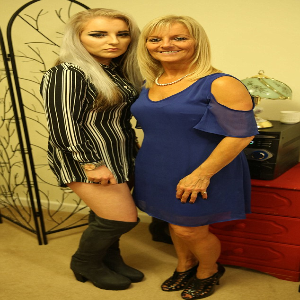


Matched with cosine similarity of: 0.1270001270001905


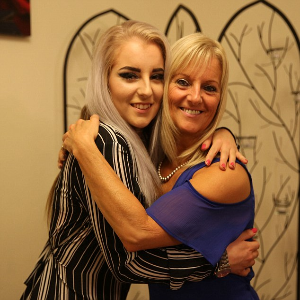


Matched with cosine similarity of: 0.1270001270001905


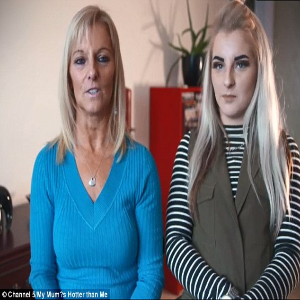


Releavent Image-->
Matched with cosine similarity of: 0.1270001270001905


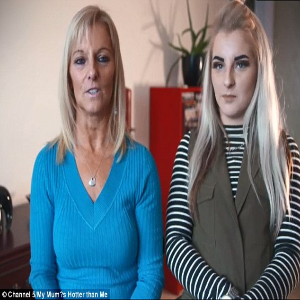


Original Summary: device brought pub pontardaw swansea 
Predicted Summary  device brought pub
[{'rouge-1': {'r': 1.0, 'p': 0.6, 'f': 0.7499999953125}, 'rouge-2': {'r': 1.0, 'p': 0.5, 'f': 0.6666666622222223}, 'rouge-l': {'r': 1.0, 'p': 0.6, 'f': 0.7499999953125}}]
Cosine similarity-->
Matched Images--->: 18
Matched with cosine similarity of: 0.031219527052723135


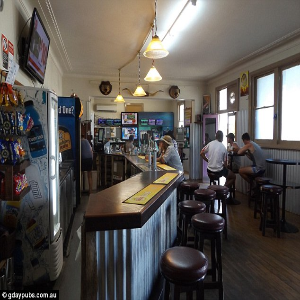


Matched with cosine similarity of: 0.08362420100070908


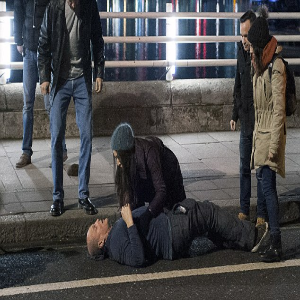


Matched with cosine similarity of: 0.14586499149789456


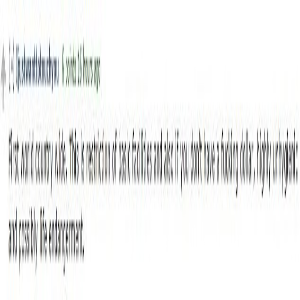


Matched with cosine similarity of: 0.1767191788821336


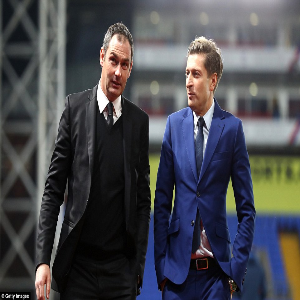


Matched with cosine similarity of: 0.1767191788821336


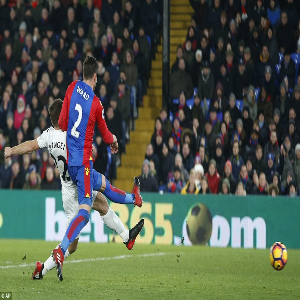


Matched with cosine similarity of: 0.1767191788821336


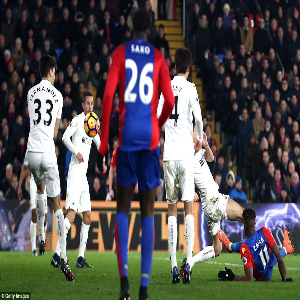


Matched with cosine similarity of: 0.1767191788821336


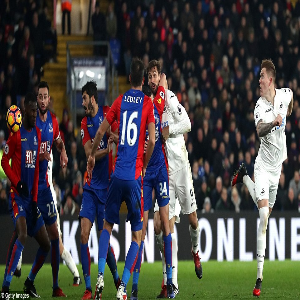


Matched with cosine similarity of: 0.1767191788821336


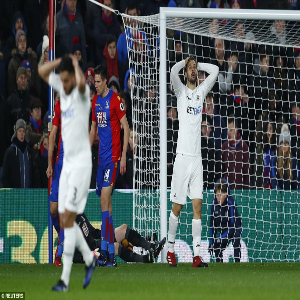


Matched with cosine similarity of: 0.1767191788821336


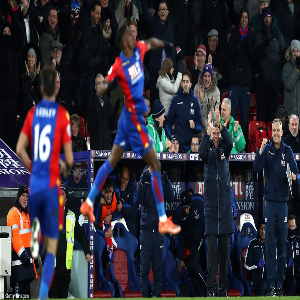


Matched with cosine similarity of: 0.1767191788821336


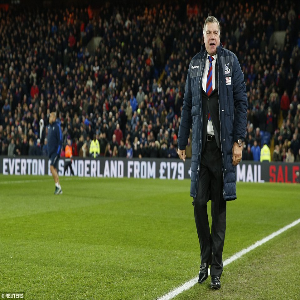


Matched with cosine similarity of: 0.1767191788821336


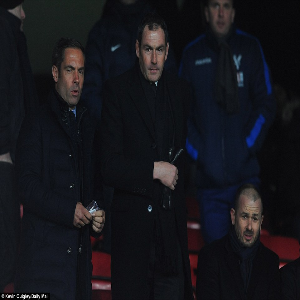


Matched with cosine similarity of: 0.1849000654084097


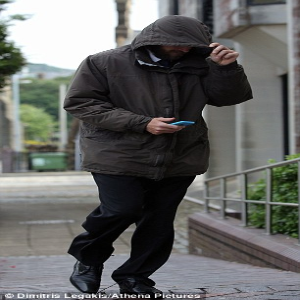


Matched with cosine similarity of: 0.1849000654084097


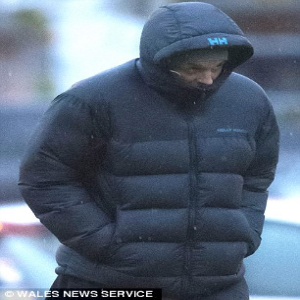


Matched with cosine similarity of: 0.2553769592276246


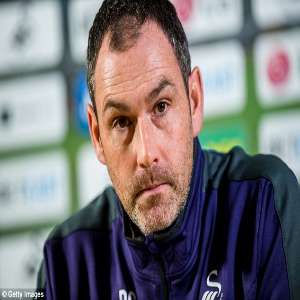


Matched with cosine similarity of: 0.2553769592276246


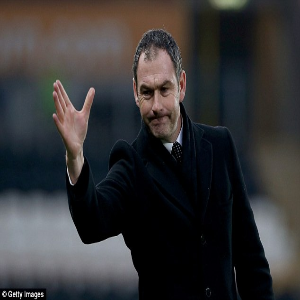


Matched with cosine similarity of: 0.2553769592276246


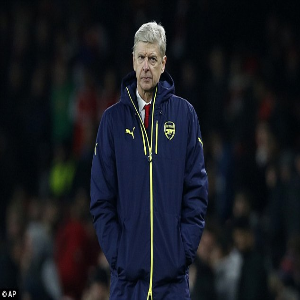


Matched with cosine similarity of: 0.2553769592276246


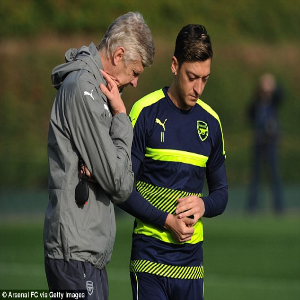


Matched with cosine similarity of: 0.2773500981126146


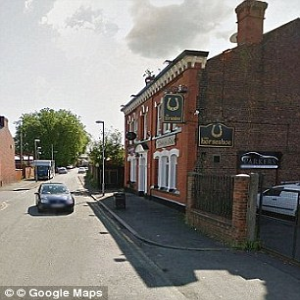


Releavent Image-->
Matched with cosine similarity of: 0.2773500981126146


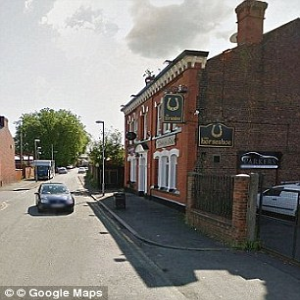


Original Summary: summary 
Predicted Summary  nan
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 15
Matched with cosine similarity of: 0.018417736717093933


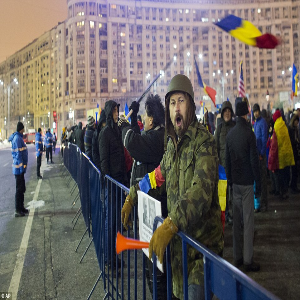


Matched with cosine similarity of: 0.018417736717093933


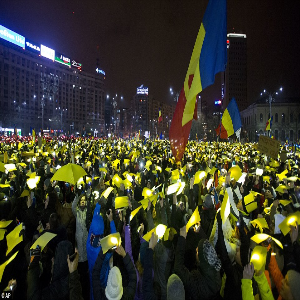


Matched with cosine similarity of: 0.018417736717093933


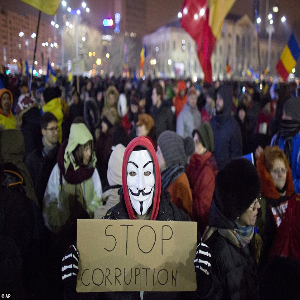


Matched with cosine similarity of: 0.018417736717093933


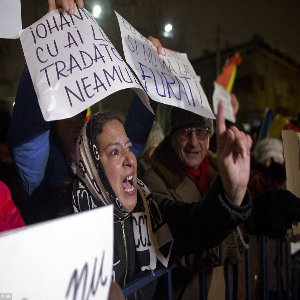


Matched with cosine similarity of: 0.018417736717093933


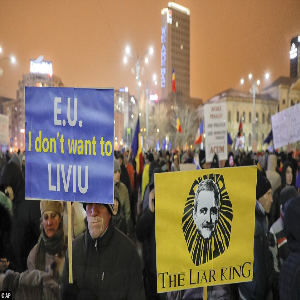


Matched with cosine similarity of: 0.018417736717093933


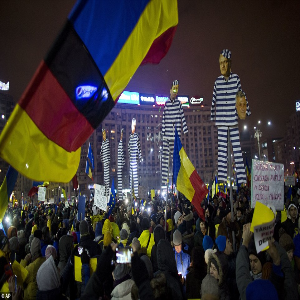


Matched with cosine similarity of: 0.018417736717093933


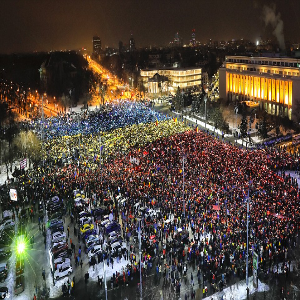


Matched with cosine similarity of: 0.018417736717093933


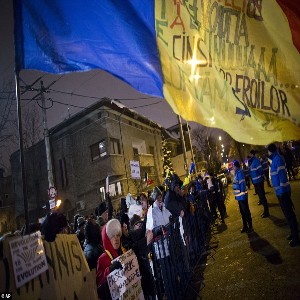


Matched with cosine similarity of: 0.018417736717093933


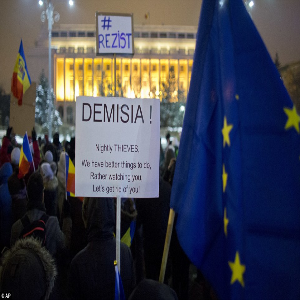


Matched with cosine similarity of: 0.018417736717093933


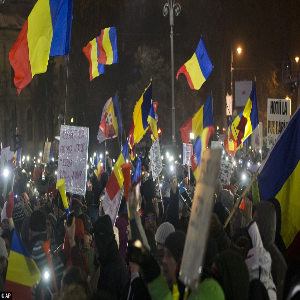


Matched with cosine similarity of: 0.018417736717093933


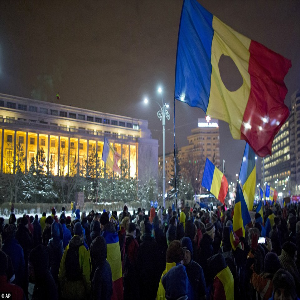


Matched with cosine similarity of: 0.018417736717093933


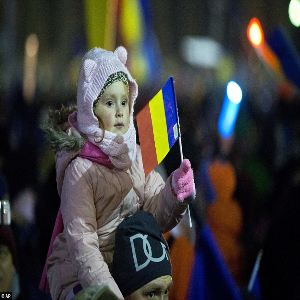


Matched with cosine similarity of: 0.018417736717093933


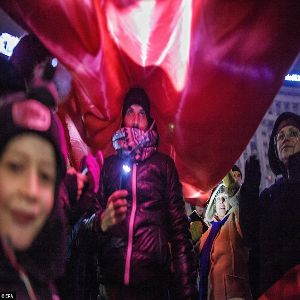


Matched with cosine similarity of: 0.018417736717093933


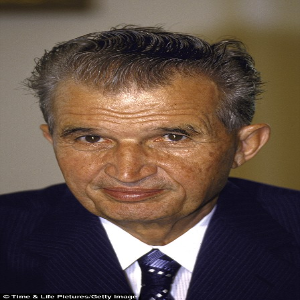


Matched with cosine similarity of: 0.018417736717093933


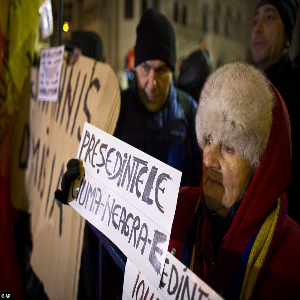


Releavent Image-->
Matched with cosine similarity of: 0.018417736717093933


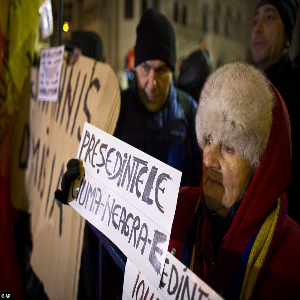


Original Summary: police alerted possible gunman us grant high school oklahoma 
Predicted Summary  police police alerted us us us involved crash tongariro forest park
[{'rouge-1': {'r': 0.375, 'p': 0.3333333333333333, 'f': 0.35294117148788934}, 'rouge-2': {'r': 0.1111111111111111, 'p': 0.125, 'f': 0.11764705384083066}, 'rouge-l': {'r': 0.375, 'p': 0.3333333333333333, 'f': 0.35294117148788934}}]
Cosine similarity-->
Matched Images--->: 14
Matched with cosine similarity of: 0.029656491293029667


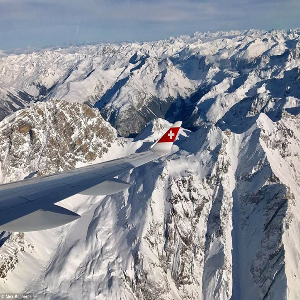


Matched with cosine similarity of: 0.030212853734454113


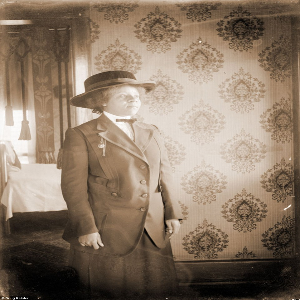


Matched with cosine similarity of: 0.033903175181040524


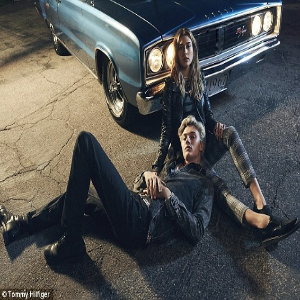


Matched with cosine similarity of: 0.07715167498104596


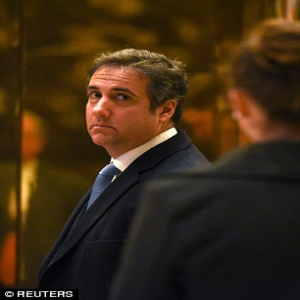


Matched with cosine similarity of: 0.11952286093343936


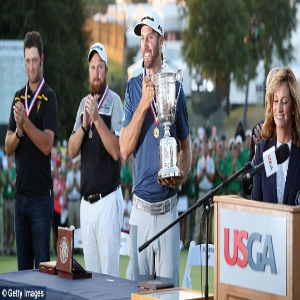


Matched with cosine similarity of: 0.16724840200141816


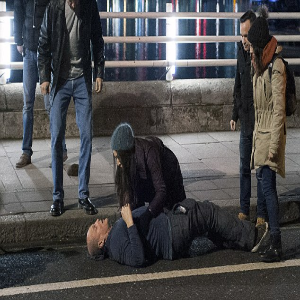


Matched with cosine similarity of: 0.2981423969999719


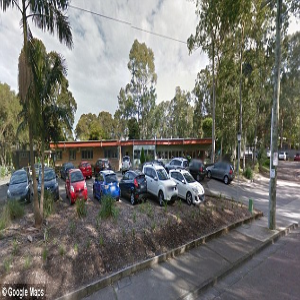


Matched with cosine similarity of: 0.2981423969999719


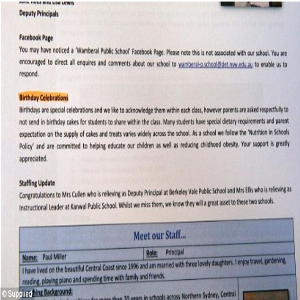


Matched with cosine similarity of: 0.3554093266554554


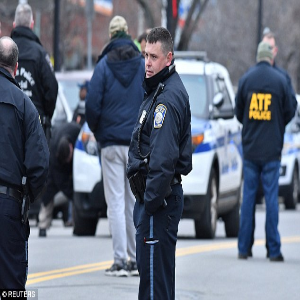


Matched with cosine similarity of: 0.3554093266554554


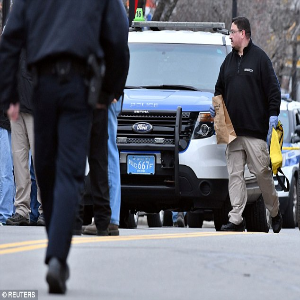


Matched with cosine similarity of: 0.3554093266554554


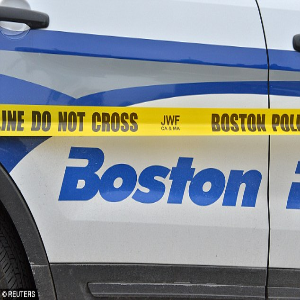


Matched with cosine similarity of: 0.3554093266554554


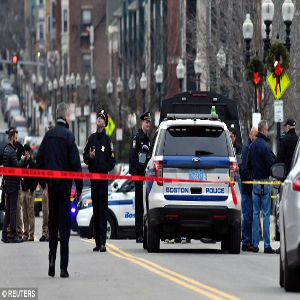


Matched with cosine similarity of: 0.3554093266554554


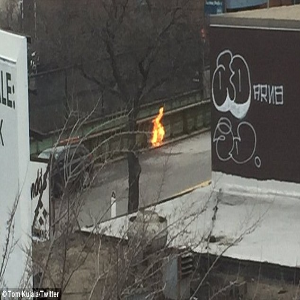


Matched with cosine similarity of: 0.3554093266554554


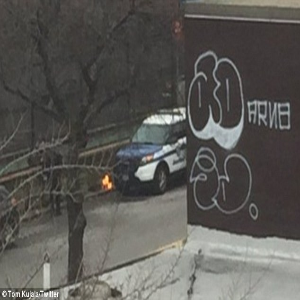


Releavent Image-->
Matched with cosine similarity of: 0.3554093266554554


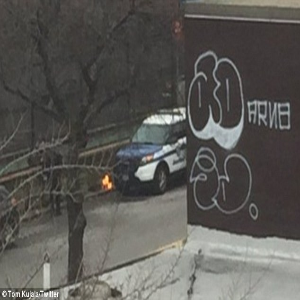


Original Summary: woman bitten snake bindi irwin australia zoo 
Predicted Summary  man man charged murder yearold
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 13
Matched with cosine similarity of: 0.04699686590921584


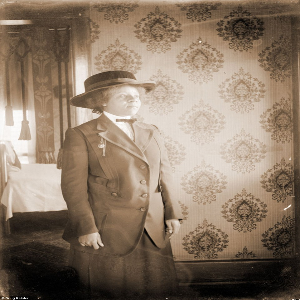


Matched with cosine similarity of: 0.15161960871578065


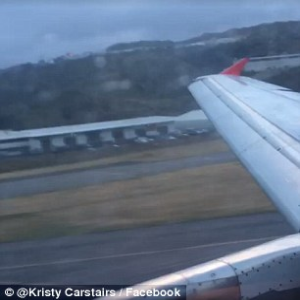


Matched with cosine similarity of: 0.1812366279990531


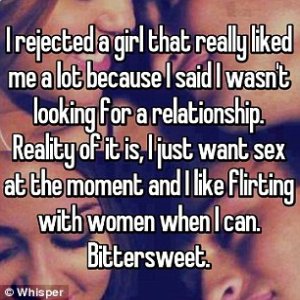


Matched with cosine similarity of: 0.25712973861329


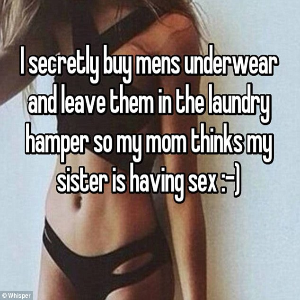


Matched with cosine similarity of: 0.25712973861329


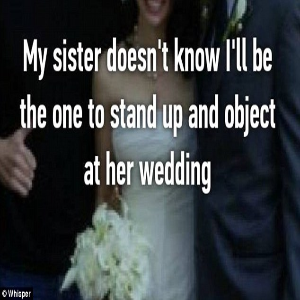


Matched with cosine similarity of: 0.28546266586299796


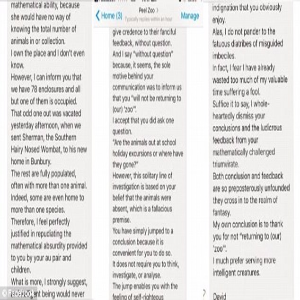


Matched with cosine similarity of: 0.29277002188455997


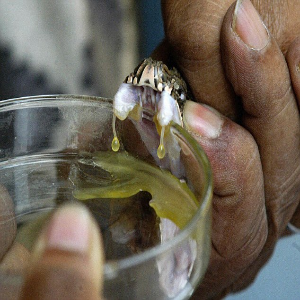


Matched with cosine similarity of: 0.29559878344928797


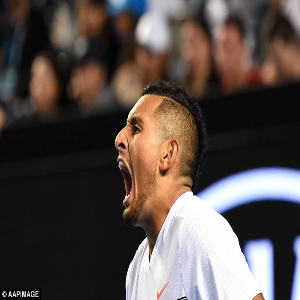


Matched with cosine similarity of: 0.29559878344928797


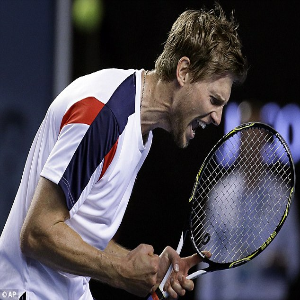


Matched with cosine similarity of: 0.39801487608399566


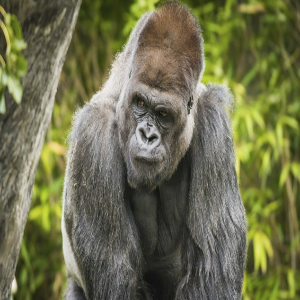


Matched with cosine similarity of: 0.39801487608399566


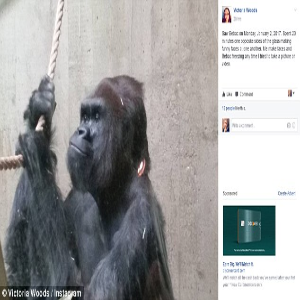


Matched with cosine similarity of: 0.39801487608399566


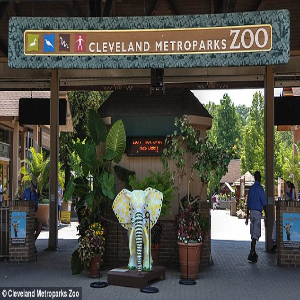


Matched with cosine similarity of: 0.39801487608399566


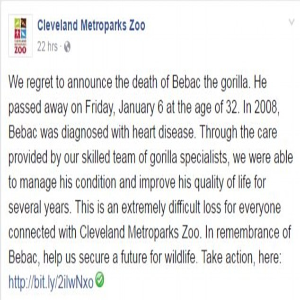


Releavent Image-->
Matched with cosine similarity of: 0.39801487608399566


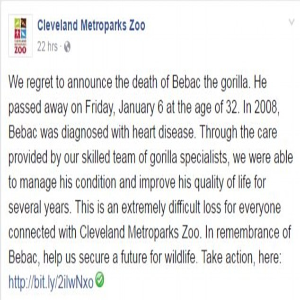


Original Summary: collection shared imgur user spookychrispratt 
Predicted Summary  collection shared imgur user
[{'rouge-1': {'r': 1.0, 'p': 0.8, 'f': 0.8888888839506174}, 'rouge-2': {'r': 1.0, 'p': 0.75, 'f': 0.8571428522448981}, 'rouge-l': {'r': 1.0, 'p': 0.8, 'f': 0.8888888839506174}}]
Cosine similarity-->
Matched Images--->: 16
Matched with cosine similarity of: 0.00587460823865198


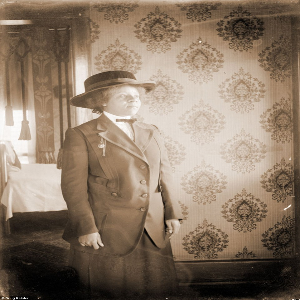


Matched with cosine similarity of: 0.08071343122712618


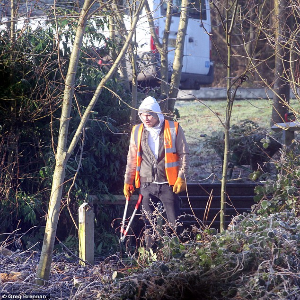


Matched with cosine similarity of: 0.09853292781642932


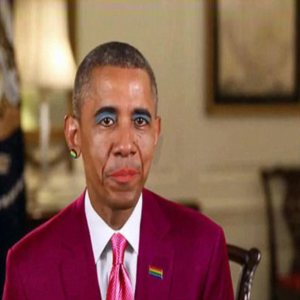


Matched with cosine similarity of: 0.09901475429766744


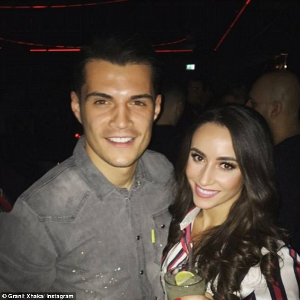


Matched with cosine similarity of: 0.14824986333222023


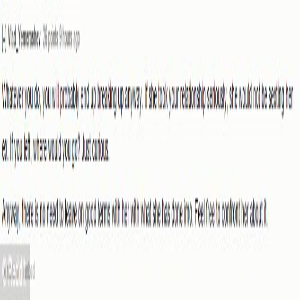


Matched with cosine similarity of: 0.2311250817605121


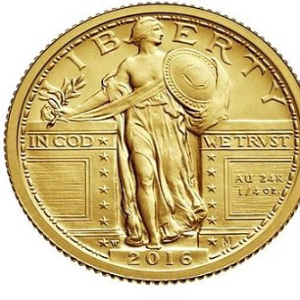


Matched with cosine similarity of: 0.2311250817605121


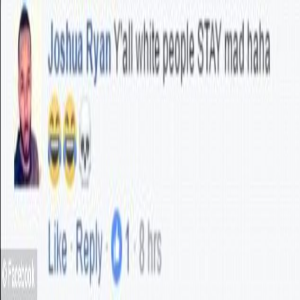


Matched with cosine similarity of: 0.2311250817605121


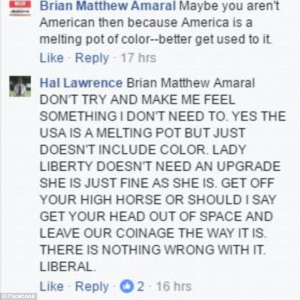


Matched with cosine similarity of: 0.2311250817605121


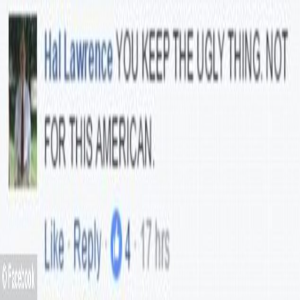


Matched with cosine similarity of: 0.2311250817605121


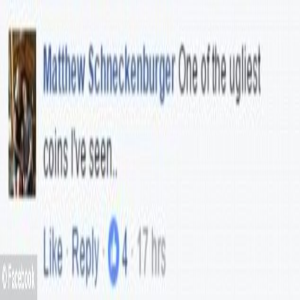


Matched with cosine similarity of: 0.2311250817605121


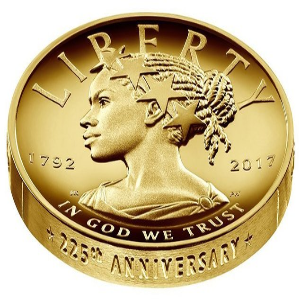


Matched with cosine similarity of: 0.2311250817605121


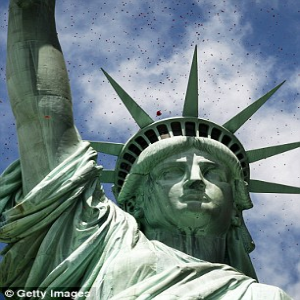


Matched with cosine similarity of: 0.2311250817605121


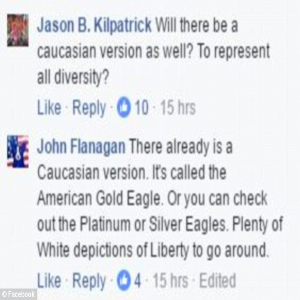


Matched with cosine similarity of: 0.2311250817605121


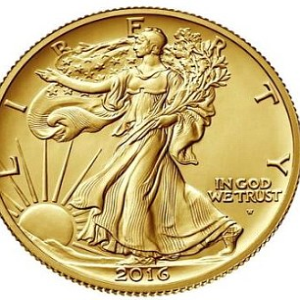


Matched with cosine similarity of: 0.2311250817605121


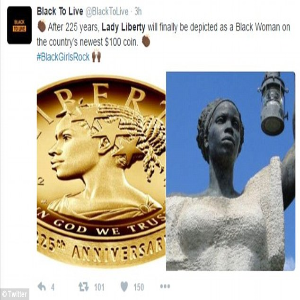


Matched with cosine similarity of: 0.2311250817605121


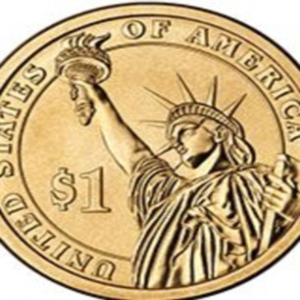


Releavent Image-->
Matched with cosine similarity of: 0.2311250817605121


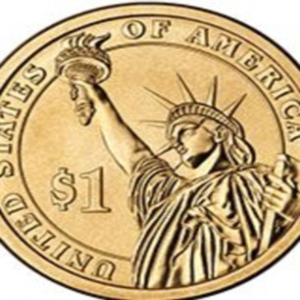


Original Summary: tassels pompoms fringing scarves nt keep necks warm 
Predicted Summary  riley alessandra found perfect fashion formula
[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}]
Cosine similarity-->
Matched Images--->: 8
Matched with cosine similarity of: 0.05399492471560388


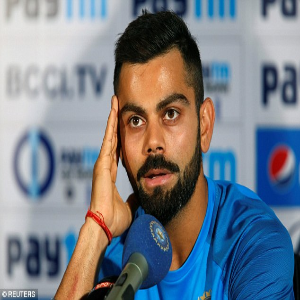


Matched with cosine similarity of: 0.08590735591751154


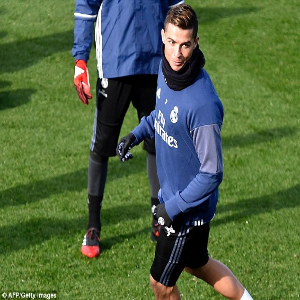


Matched with cosine similarity of: 0.1072112534837795


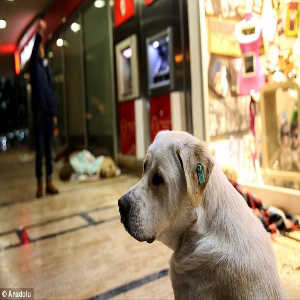


Matched with cosine similarity of: 0.1072112534837795


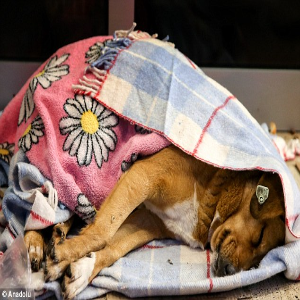


Matched with cosine similarity of: 0.21259760138109354


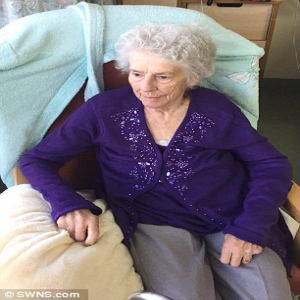


Matched with cosine similarity of: 0.21259760138109354


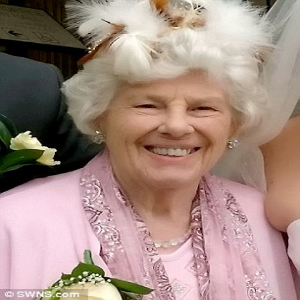


Matched with cosine similarity of: 0.21259760138109354


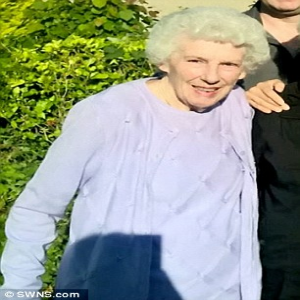


Matched with cosine similarity of: 0.21259760138109354


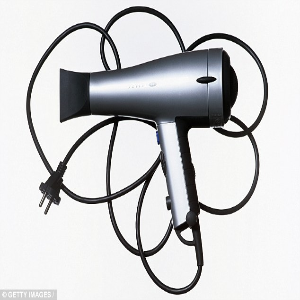


Releavent Image-->
Matched with cosine similarity of: 0.21259760138109354


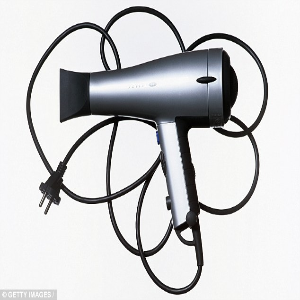

In [ ]:
c=0
for i in k:
  #heading=check(news_[c])
  #print(f"#{c+1} {heading}:-",news_[c])
  print("Original Summary:",i[0])
  print("Predicted Summary",i[1])
  g=r.get_scores(i[0],i[1])
  print(g)
  '''if news_[c]==None or news_[c]==""or str(news_[c])=="nan":
    #img_id=get_img_id(i[0])
    #print_img(data["ImgId"][img_id])
    continue
  else:
    #img_id=get_img_id(news_[c])
    #img_id=get_img_id(img_ids,i[0])
    #print_img(data["ImgId"][img_id])'''
  print("Cosine similarity-->")
  c_ind,ind,img_ids,values=co_sim(i[0])
  resultants.append([i[0],i[1],ind,c_ind])
  print("Matched Images--->:",len(img_ids))
  for j in range(len(img_ids)):
    print("Matched with cosine similarity of:",values[j])
    print_img(data["ImgId"][img_ids[j]])
    print()
  print("Releavent Image-->")
  print("Matched with cosine similarity of:",c_ind)
  print_img(data["ImgId"][ind])
  print()
  c+=1

In [13]:
len(resultants)

14

Reference: police say uk us involved crash tongariro forest park new zealand
Predicted: police police alerted us us us involved crash tongariro forest park new
Best Matched Image:
Matched with cosine similarity of: 0.3554093266554554


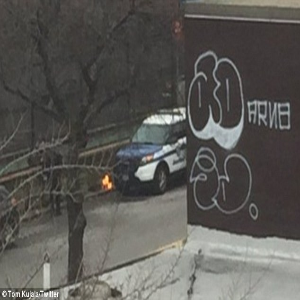


Reference: elderly man charged murder yearold partner
Predicted: man man man charged yearold
Best Matched Image:
Matched with cosine similarity of: 0.31799936400190804


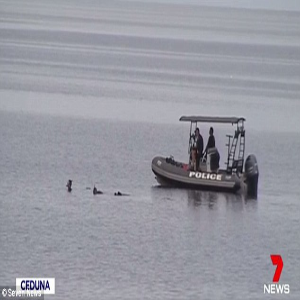


Reference: man body found backyard south east melbourne
Predicted: man man man charged murder
Best Matched Image:
Matched with cosine similarity of: 0.31622776601683794


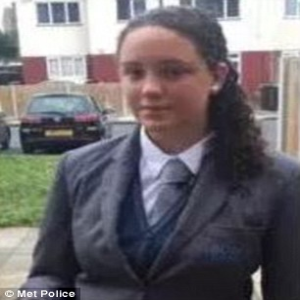


Reference: within minutes account accumulated million followers
Predicted: man man man found
Best Matched Image:
Matched with cosine similarity of: 0.2581988897471611


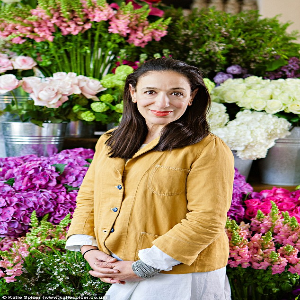


Reference: thomas jefferson hotel birmingham completed
Predicted: nan
Best Matched Image:
Matched with cosine similarity of: 0.3922322702763681


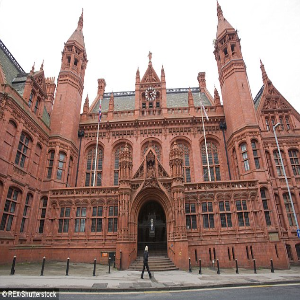


Reference: dakar rally winding way across miles three countries south america
Predicted: police police uk us involved crash tongariro forest park new
Best Matched Image:
Matched with cosine similarity of: 0.26111648393354675


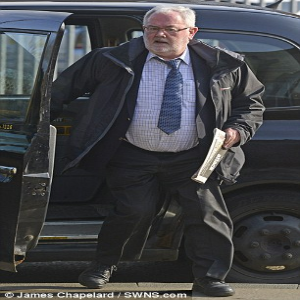


Reference: parents taken whisper reveal oddest rules make
Predicted: collection imgur imgur imgur
Best Matched Image:
Matched with cosine similarity of: 0.22645540682891913


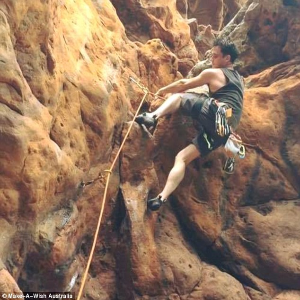


Reference: pictures show two male lions thought brothers attack kill buffalo
Predicted: police uk us involved involved
Best Matched Image:
Matched with cosine similarity of: 0.40201512610368484


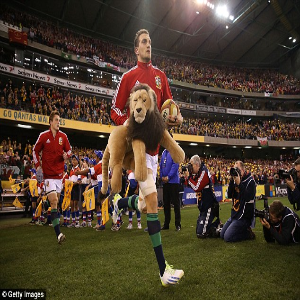


Reference: riley alessandra found perfect fashion formula rock winter long
Predicted: riley alessandra perfect perfect fashion formula
Best Matched Image:
Matched with cosine similarity of: 0.31622776601683794


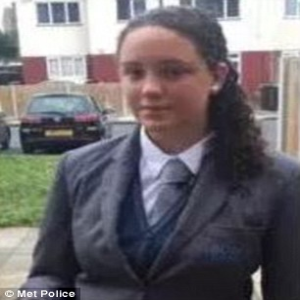


Reference: device brought pub pontardaw swansea
Predicted: device brought pub
Best Matched Image:
Matched with cosine similarity of: 0.2773500981126146


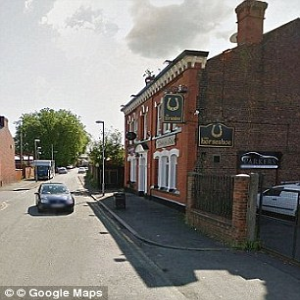


Reference: police alerted possible gunman us grant high school oklahoma
Predicted: police police alerted us us us involved crash tongariro forest park
Best Matched Image:
Matched with cosine similarity of: 0.3554093266554554


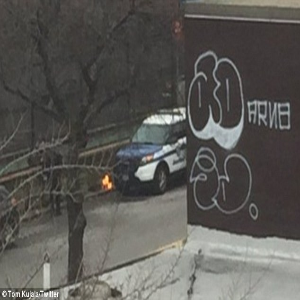


Reference: woman bitten snake bindi irwin australia zoo
Predicted: man man charged murder yearold
Best Matched Image:
Matched with cosine similarity of: 0.39801487608399566


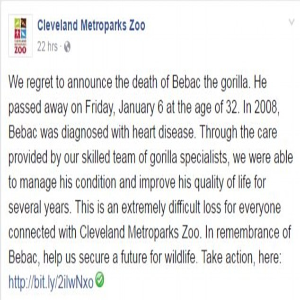


Reference: collection shared imgur user spookychrispratt
Predicted: collection shared imgur user
Best Matched Image:
Matched with cosine similarity of: 0.2311250817605121


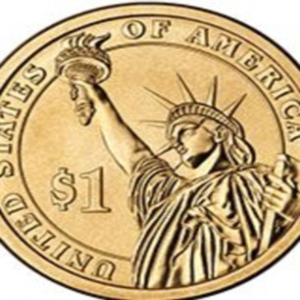


Reference: tassels pompoms fringing scarves nt keep necks warm
Predicted: riley alessandra found perfect fashion formula
Best Matched Image:
Matched with cosine similarity of: 0.21259760138109354


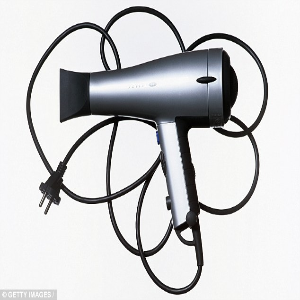

In [24]:
for i in resultants:
  reference,predicted,best_match,c_score = i
  print("Reference:",reference)
  print("Predicted:",predicted)
  print("Best Matched Image:")
  print("Matched with cosine similarity of:",c_score)
  print_img(data["ImgId"][best_match])
  print()